## Исследование данных о Рынке заведений общественного питания Москвы

План работ:
1. изучить датафрейм.
2. Проверить типы данных в датафрейме и преобразовать там, где это необходимо.
3. Изучить пропуски в датафрейме. Объяснить, почему заполнил пропуски определённым образом или почему не стал это делать.
4. Проверить, есть ли в данных дубликаты. Описать причины, которые могли повлиять на появление дублей.
5. Изучить столбцы, которые содержат категориальные значения:
6. Выполнить предобработку данных:
- Создать столбец street с названиями улиц из столбца с адресом.
- Создать столбец is_24_7 с обозначением, что заведение работает ежедневно и круглосуточно (24/7):
- логическое значение True — если заведение работает ежедневно и круглосуточно, логическое значение False — в противоположном случае.
7. Анализ данных
- Какие категории заведений представлены в данных? Исследовать количество объектов общественного питания по категориям: рестораны, кофейни, пиццерии, бары и так далее. Построить визуализации. Ответить на вопрос о распределении заведений по категориям.
- Исследовать количество посадочных мест в местах по категориям: рестораны, кофейни, пиццерии, бары и так далее. Построить визуализации. Проанализировать результаты и сделать выводы.
- Рассмотреть и изобразить соотношение сетевых и несетевых заведений в датасете. Каких заведений больше?
- Какие категории заведений чаще являются сетевыми? Исследовать данные и ответить на вопрос графиком.
- Сгруппировать данные по названиям заведений и найти топ-15 популярных сетей в Москве. Под популярностью понимается количество заведений этой сети в регионе. Построить подходящую для такой информации визуализацию. Знакомы ли эти сети? Есть ли какой-то признак, который их объединяет? К какой категории заведений они относятся?
- Какие административные районы Москвы присутствуют в датасете? Отобразить общее количество заведений и количество заведений каждой категории по районам. Попробовать проиллюстрировать эту информацию одним графиком.
- Визуализировать распределение средних рейтингов по категориям заведений. Сильно ли различаются усреднённые рейтинги в разных типах общепита?
- Построить фоновую картограмму (хороплет) со средним рейтингом заведений каждого района. Границы районов Москвы, которые встречаются в датасете, хранятся в файле admin_level_geomap.geojson
- Отобразить все заведения датасета на карте с помощью кластеров средствами библиотеки folium.
- Найти топ-15 улиц по количеству заведений. Построить график распределения количества заведений и их категорий по этим улицам. Попробовать проиллюстрировать эту информацию одним графиком.
- Найти улицы, на которых находится только один объект общепита. Что можно сказать об этих заведениях?
- Значения средних чеков заведений хранятся в столбце middle_avg_bill. Эти числа показывают примерную стоимость заказа в рублях, которая чаще всего выражена диапазоном. Посчитать медиану этого столбца для каждого района. Используйте это значение в качестве ценового индикатора района. Построить фоновую картограмму (хороплет) с полученными значениями для каждого района. Проанализировать цены в центральном административном округе и других. Как удалённость от центра влияет на цены в заведениях?
- Необязательное задание: проиллюстрировать другие взаимосвязи, которые вы нашли в данных. Например, по желанию исследовать часы работы заведений и их зависимость от расположения и категории заведения. Также можно исследовать особенности заведений с плохими рейтингами, средние чеки в таких местах и распределение по категориям заведений.
- Соберать наблюдения по вопросам выше в один общий вывод.
8. Ответить на следующие вопросы:
- Сколько всего кофеен в датасете? В каких районах их больше всего, каковы особенности их расположения?
- Есть ли круглосуточные кофейни?
- Какие у кофеен рейтинги? Как они распределяются по районам?
- На какую стоимость чашки капучино стоит ориентироваться при открытии и почему?
- Построить визуализации. Попробовать дать рекомендацию для открытия нового заведения. Это творческое задание, но решение должно быть чем-то обосновано. Объяснить свою рекомендацию  текстом с описанием или маркерами на географической карте.
9. Выбрать важные тезисы и наблюдения, которые могут заинтересовать заказчиков. 
10. подготовить перезентацию

### Шаг 1. Изучения файла с данными

In [1]:
import pandas as pd
import plotly.express as px
from plotly import graph_objects as go
import matplotlib.pyplot as plt
import seaborn as sns

In [2]:
pip install folium

Note: you may need to restart the kernel to use updated packages.


In [3]:
df = pd.read_csv(r"C:\Users\SubKi\Downloads\data_sets\moscow_places.csv")

In [4]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8406 entries, 0 to 8405
Data columns (total 14 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   name               8406 non-null   object 
 1   category           8406 non-null   object 
 2   address            8406 non-null   object 
 3   district           8406 non-null   object 
 4   hours              7870 non-null   object 
 5   lat                8406 non-null   float64
 6   lng                8406 non-null   float64
 7   rating             8406 non-null   float64
 8   price              3315 non-null   object 
 9   avg_bill           3816 non-null   object 
 10  middle_avg_bill    3149 non-null   float64
 11  middle_coffee_cup  535 non-null    float64
 12  chain              8406 non-null   int64  
 13  seats              4795 non-null   float64
dtypes: float64(6), int64(1), object(7)
memory usage: 919.5+ KB


In [5]:
df.head()

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats
0,WoWфли,кафе,"Москва, улица Дыбенко, 7/1",Северный административный округ,"ежедневно, 10:00–22:00",55.878494,37.478860,5.0,NaN,NaN,NaN,NaN,0,NaN
1,Четыре комнаты,ресторан,"Москва, улица Дыбенко, 36, корп. 1",Северный административный округ,"ежедневно, 10:00–22:00",55.875801,37.484479,4.5,выше среднего,Средний счёт:1500–1600 ₽,1550.0,NaN,0,4.0
2,Хазри,кафе,"Москва, Клязьминская улица, 15",Северный административный округ,"пн-чт 11:00–02:00; пт,сб 11:00–05:00; вс 11:00...",55.889146,37.525901,4.6,средние,Средний счёт:от 1000 ₽,1000.0,NaN,0,45.0
3,Dormouse Coffee Shop,кофейня,"Москва, улица Маршала Федоренко, 12",Северный административный округ,"ежедневно, 09:00–22:00",55.881608,37.488860,5.0,NaN,Цена чашки капучино:155–185 ₽,NaN,170.0,0,NaN
4,Иль Марко,пиццерия,"Москва, Правобережная улица, 1Б",Северный административный округ,"ежедневно, 10:00–22:00",55.881166,37.449357,5.0,средние,Средний счёт:400–600 ₽,500.0,NaN,1,148.0


Text(0, 0.5, 'частота')

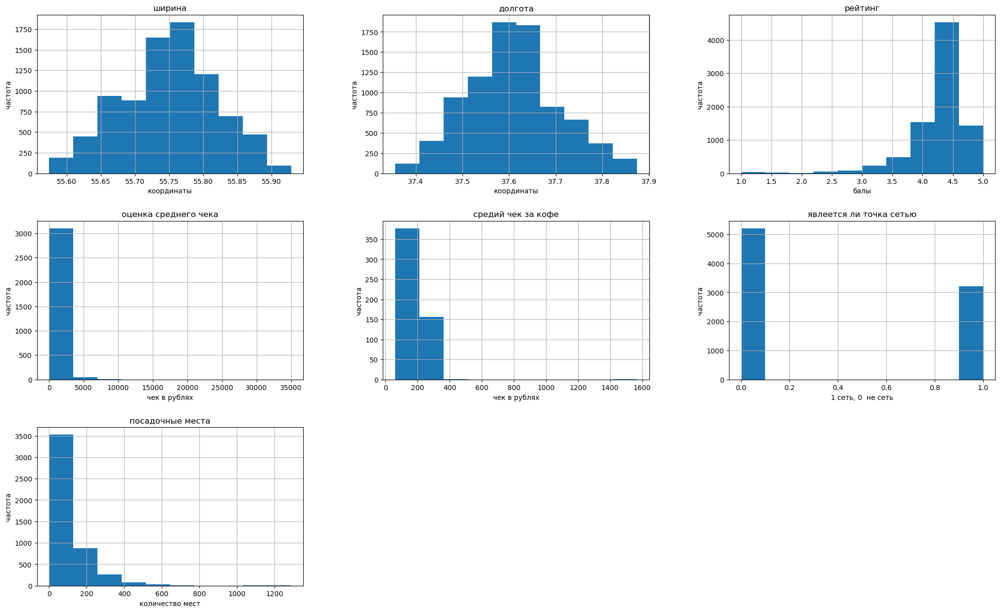

In [6]:
axes = df.hist(figsize = (25,15))
axes[0,0].set_title('ширина')
axes[0,0].set_xlabel('координаты')
axes[0,0].set_ylabel('частота')

axes[0,1].set_title('долгота')
axes[0,1].set_xlabel('координаты')
axes[0,1].set_ylabel('частота')

axes[0,2].set_title('рейтинг')
axes[0,2].set_xlabel('балы')
axes[0,2].set_ylabel('частота')

axes[1,0].set_title('оценка среднего чека')
axes[1,0].set_xlabel('чек в рублях')
axes[1,0].set_ylabel('частота')

axes[1,1].set_title('средий чек за кофе')
axes[1,1].set_xlabel('чек в рублях')
axes[1,1].set_ylabel('частота')

axes[1,2].set_title('явлеется ли точка сетью')
axes[1,2].set_xlabel('1 сеть, 0  не сеть')
axes[1,2].set_ylabel('частота')

axes[2,0].set_title('посадочные места')
axes[2,0].set_xlabel('количество мест')
axes[2,0].set_ylabel('частота')

In [7]:
check_df = df.shape[0]  # создаем переменную с размером датасета до преобразования
check_df

8406

#### промежуточный вывод. Знакомство с данными
На первый взгляд столбцы имеют правльный тип данных,по гистограмам видно что столбцов с числовыми данными почти у всех идёт нормальное распределение кроме, среднего чека и чека за кофе, там есть выбросы которые можно изучить.

## Шаг 2.1. предобработка данных

In [8]:
df['rating'].unique()

array([5. , 4.5, 4.6, 4.4, 4.7, 4.8, 4.3, 4.9, 4.2, 4.1, 4. , 3.8, 3.9,
       3.7, 3.6, 2.8, 2.7, 3.1, 1.5, 2. , 1.4, 3.3, 3.5, 3.2, 2.9, 3. ,
       3.4, 2.3, 2.2, 2.5, 2.6, 1.7, 1. , 1.1, 2.4, 1.3, 1.2, 2.1, 1.8,
       1.9, 1.6])

In [9]:
df['rating'].max()

5.0

In [10]:
df['price'].unique()

array([nan, 'выше среднего', 'средние', 'высокие', 'низкие'], dtype=object)

In [11]:
df['district'].unique()

array(['Северный административный округ',
       'Северо-Восточный административный округ',
       'Северо-Западный административный округ',
       'Западный административный округ',
       'Центральный административный округ',
       'Восточный административный округ',
       'Юго-Восточный административный округ',
       'Южный административный округ',
       'Юго-Западный административный округ'], dtype=object)

In [12]:
df['chain'].unique()

array([0, 1], dtype=int64)

 - Проверил категориальные столбцы, на наличие аномалий. Аномалии отсутствуют. Категоролиальные столбцы готовы к работе.


###  пропуски в датафрейме


In [13]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8406 entries, 0 to 8405
Data columns (total 14 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   name               8406 non-null   object 
 1   category           8406 non-null   object 
 2   address            8406 non-null   object 
 3   district           8406 non-null   object 
 4   hours              7870 non-null   object 
 5   lat                8406 non-null   float64
 6   lng                8406 non-null   float64
 7   rating             8406 non-null   float64
 8   price              3315 non-null   object 
 9   avg_bill           3816 non-null   object 
 10  middle_avg_bill    3149 non-null   float64
 11  middle_coffee_cup  535 non-null    float64
 12  chain              8406 non-null   int64  
 13  seats              4795 non-null   float64
dtypes: float64(6), int64(1), object(7)
memory usage: 919.5+ KB


In [14]:
df.isna().sum()

name                    0
category                0
address                 0
district                0
hours                 536
lat                     0
lng                     0
rating                  0
price                5091
avg_bill             4590
middle_avg_bill      5257
middle_coffee_cup    7871
chain                   0
seats                3611
dtype: int64

In [15]:
df['hours'].head()


0                               ежедневно, 10:00–22:00
1                               ежедневно, 10:00–22:00
2    пн-чт 11:00–02:00; пт,сб 11:00–05:00; вс 11:00...
3                               ежедневно, 09:00–22:00
4                               ежедневно, 10:00–22:00
Name: hours, dtype: object

In [16]:
df['hours'].nunique()

1307

In [17]:
df['hours'].value_counts()

hours
ежедневно, 10:00–22:00                                                  759
ежедневно, круглосуточно                                                730
ежедневно, 11:00–23:00                                                  396
ежедневно, 10:00–23:00                                                  310
ежедневно, 12:00–00:00                                                  254
                                                                       ... 
пн-пт 17:00–03:00; сб,вс 17:00–05:00                                      1
пн,вт 09:00–21:00; ср-пт 09:00–22:00; сб 10:00–22:00; вс 10:00–21:00      1
пн-пт 12:00–01:00                                                         1
пн-пт 10:30–21:30; сб,вс 10:30–22:30                                      1
пн-сб 10:30–21:30                                                         1
Name: count, Length: 1307, dtype: int64

- В столбце слишком вариаций того, как работают магазины, подобрать среднее не получится, если удалить пропуски, слишком много данных будет потеряно.

In [18]:
df['price'].isna().sum()

5091

In [19]:
df[df['price'].isna()].head()

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats
0,WoWфли,кафе,"Москва, улица Дыбенко, 7/1",Северный административный округ,"ежедневно, 10:00–22:00",55.878494,37.478860,5.0,NaN,NaN,NaN,NaN,0,NaN
3,Dormouse Coffee Shop,кофейня,"Москва, улица Маршала Федоренко, 12",Северный административный округ,"ежедневно, 09:00–22:00",55.881608,37.488860,5.0,NaN,Цена чашки капучино:155–185 ₽,NaN,170.0,0,NaN
11,Шашлык Шефф,кафе,"Москва, улица Маршала Федоренко, 10с1",Северный административный округ,"ежедневно, 10:00–21:00",55.881770,37.492362,4.9,NaN,NaN,NaN,NaN,0,NaN
13,Буханка,булочная,"Москва, Базовская улица, 15, корп. 1",Северный административный округ,"ежедневно, 08:00–22:00",55.877007,37.504980,4.8,NaN,NaN,NaN,NaN,1,180.0
19,Пекарня,булочная,"Москва, Ижорский проезд, 5",Северный административный округ,"ежедневно, круглосуточно",55.887969,37.515688,4.4,NaN,NaN,NaN,NaN,1,NaN


Нет возможности подобрать альтернативу и слишком много пропущенных значений для удаления, чтобы не исказить результаты. 

In [20]:
df['avg_bill'].isna().sum()

4590

In [21]:
df[df['avg_bill'].isna()].head()

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats
0,WoWфли,кафе,"Москва, улица Дыбенко, 7/1",Северный административный округ,"ежедневно, 10:00–22:00",55.878494,37.478860,5.0,NaN,NaN,NaN,NaN,0,NaN
5,Sergio Pizza,пиццерия,"Москва, Ижорская улица, вл8Б",Северный административный округ,"ежедневно, 10:00–23:00",55.888010,37.509573,4.6,средние,NaN,NaN,NaN,0,NaN
11,Шашлык Шефф,кафе,"Москва, улица Маршала Федоренко, 10с1",Северный административный округ,"ежедневно, 10:00–21:00",55.881770,37.492362,4.9,NaN,NaN,NaN,NaN,0,NaN
13,Буханка,булочная,"Москва, Базовская улица, 15, корп. 1",Северный административный округ,"ежедневно, 08:00–22:00",55.877007,37.504980,4.8,NaN,NaN,NaN,NaN,1,180.0
19,Пекарня,булочная,"Москва, Ижорский проезд, 5",Северный административный округ,"ежедневно, круглосуточно",55.887969,37.515688,4.4,NaN,NaN,NaN,NaN,1,NaN


Нет возможности подобрать альтернативу и слишком много пропущенных значений для удаления, чтобы не исказить результаты. 

In [22]:
df['middle_avg_bill'].isna().sum()

5257

In [23]:
df[df['middle_avg_bill'].isna()].head()

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats
0,WoWфли,кафе,"Москва, улица Дыбенко, 7/1",Северный административный округ,"ежедневно, 10:00–22:00",55.878494,37.478860,5.0,NaN,NaN,NaN,NaN,0,NaN
3,Dormouse Coffee Shop,кофейня,"Москва, улица Маршала Федоренко, 12",Северный административный округ,"ежедневно, 09:00–22:00",55.881608,37.488860,5.0,NaN,Цена чашки капучино:155–185 ₽,NaN,170.0,0,NaN
5,Sergio Pizza,пиццерия,"Москва, Ижорская улица, вл8Б",Северный административный округ,"ежедневно, 10:00–23:00",55.888010,37.509573,4.6,средние,NaN,NaN,NaN,0,NaN
10,Great Room Bar,"бар,паб","Москва, Левобережная улица, 12",Северный административный округ,"ежедневно, круглосуточно",55.877832,37.469171,4.5,средние,Цена бокала пива:250–350 ₽,NaN,NaN,0,102.0
11,Шашлык Шефф,кафе,"Москва, улица Маршала Федоренко, 10с1",Северный административный округ,"ежедневно, 10:00–21:00",55.881770,37.492362,4.9,NaN,NaN,NaN,NaN,0,NaN


- Нет возможности подобрать альтернативу и слишком много пропущенных значений для удаления, чтобы не исказить результаты. 

In [24]:
df['middle_coffee_cup'].isna().sum()

7871

In [25]:
df[df['middle_coffee_cup'].isna()].head()

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats
0,WoWфли,кафе,"Москва, улица Дыбенко, 7/1",Северный административный округ,"ежедневно, 10:00–22:00",55.878494,37.478860,5.0,NaN,NaN,NaN,NaN,0,NaN
1,Четыре комнаты,ресторан,"Москва, улица Дыбенко, 36, корп. 1",Северный административный округ,"ежедневно, 10:00–22:00",55.875801,37.484479,4.5,выше среднего,Средний счёт:1500–1600 ₽,1550.0,NaN,0,4.0
2,Хазри,кафе,"Москва, Клязьминская улица, 15",Северный административный округ,"пн-чт 11:00–02:00; пт,сб 11:00–05:00; вс 11:00...",55.889146,37.525901,4.6,средние,Средний счёт:от 1000 ₽,1000.0,NaN,0,45.0
4,Иль Марко,пиццерия,"Москва, Правобережная улица, 1Б",Северный административный округ,"ежедневно, 10:00–22:00",55.881166,37.449357,5.0,средние,Средний счёт:400–600 ₽,500.0,NaN,1,148.0
5,Sergio Pizza,пиццерия,"Москва, Ижорская улица, вл8Б",Северный административный округ,"ежедневно, 10:00–23:00",55.888010,37.509573,4.6,средние,NaN,NaN,NaN,0,NaN


- Нет возможности подобрать альтернативу и слишком много пропущенных значений для удаления, чтобы не исказить результаты. 

In [26]:
df['seats'].isna().sum()

3611

In [27]:
df[df['seats'].isna()].head()

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats
0,WoWфли,кафе,"Москва, улица Дыбенко, 7/1",Северный административный округ,"ежедневно, 10:00–22:00",55.878494,37.478860,5.0,NaN,NaN,NaN,NaN,0,NaN
3,Dormouse Coffee Shop,кофейня,"Москва, улица Маршала Федоренко, 12",Северный административный округ,"ежедневно, 09:00–22:00",55.881608,37.488860,5.0,NaN,Цена чашки капучино:155–185 ₽,NaN,170.0,0,NaN
5,Sergio Pizza,пиццерия,"Москва, Ижорская улица, вл8Б",Северный административный округ,"ежедневно, 10:00–23:00",55.888010,37.509573,4.6,средние,NaN,NaN,NaN,0,NaN
11,Шашлык Шефф,кафе,"Москва, улица Маршала Федоренко, 10с1",Северный административный округ,"ежедневно, 10:00–21:00",55.881770,37.492362,4.9,NaN,NaN,NaN,NaN,0,NaN
12,Заправка,кафе,"Москва, МКАД, 80-й километр, 1",Северный административный округ,вт-сб 09:00–18:00,55.899938,37.517958,4.3,средние,Средний счёт:330 ₽,330.0,NaN,0,NaN


- Нет возможности подобрать альтернативу и слишком много пропущенных значений для удаления, чтобы не исказить результаты. 

#### Промежуточный вывод. Пропущеные значения.
Из за того что информация, размещённая в сервисе Яндекс Бизнес, могла быть добавлена пользователями или найдена в общедоступных источниках и добавлялась по возможности, много данных не хватает. Удалить или заменить на альтернативу нет возможности. будет сильно искажён результат.

###  Дубликаты в датафрейме

In [28]:
df.duplicated().sum()

0

- Полных дубликатов в датафрейме нет

In [29]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8406 entries, 0 to 8405
Data columns (total 14 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   name               8406 non-null   object 
 1   category           8406 non-null   object 
 2   address            8406 non-null   object 
 3   district           8406 non-null   object 
 4   hours              7870 non-null   object 
 5   lat                8406 non-null   float64
 6   lng                8406 non-null   float64
 7   rating             8406 non-null   float64
 8   price              3315 non-null   object 
 9   avg_bill           3816 non-null   object 
 10  middle_avg_bill    3149 non-null   float64
 11  middle_coffee_cup  535 non-null    float64
 12  chain              8406 non-null   int64  
 13  seats              4795 non-null   float64
dtypes: float64(6), int64(1), object(7)
memory usage: 919.5+ KB


In [30]:
df['name'].duplicated().sum()

2792

In [31]:
df['name'] = df['name'].str.lower()

In [32]:
df['name'].duplicated().sum()

2894

In [33]:
df.duplicated().sum()

0

In [34]:
df['name'].value_counts().head(50)

name
кафе                                   189
шоколадница                            120
домино'с пицца                          77
додо пицца                              74
one price coffee                        72
яндекс лавка                            69
cofix                                   65
prime                                   50
хинкальная                              44
шаурма                                  43
кофепорт                                42
кулинарная лавка братьев караваевых     39
теремок                                 38
чайхана                                 37
ресторан                                34
буханка                                 32
cofefest                                32
столовая                                28
му-му                                   27
drive café                              24
кофемания                               23
крошка картошка                         22
андерсон                                22
скалка

In [35]:
df['name'].value_counts().tail(50)

name
артмелон лайф                 1
кафе бар семави               1
бакинский рай                 1
лампа                         1
kano                          1
4friends coffee               1
хинкальная ламазо             1
кирин                         1
bklyn: brooklyn pizza pie     1
рублёв                        1
friends & family              1
рhово                         1
мята                          1
французская пекарня delice    1
сащя                          1
stardogs                      1
bar park 15                   1
drive                         1
bassg                         1
мазза                         1
вайбс                         1
хаус бар                      1
5 stars coffee                1
ретро-буфет                   1
царская трапеза               1
донер & клаб                  1
ресторан тройка               1
эль-шарк                      1
бабушкин буфет                1
ледовый дворец                1
мой дом                       1
про

In [36]:
def change_name(value):
    if value in ('кафе', 'ресторан', 'столовая'):
        return 'не известно'
    else:
        return value

df['name'] = df['name'].apply(change_name)

In [37]:
df['name'].value_counts()

name
не известно         251
шоколадница         120
домино'с пицца       77
додо пицца           74
one price coffee     72
                   ... 
ах... плов            1
прошу к столу         1
кофе-порт             1
сметана               1
kebab time            1
Name: count, Length: 5510, dtype: int64

#### Промежуточный вывод. Дубликаты.
- Нашёл неявные дубликаты за счёт приведения названия точек общепита к нижнему регистру. Дубликаты встречаются так как есть сети магазинов, так и простые названия  как "кафе", "ресторан" и "столовая" такие я переименовал " не известно". Если применть изминение ё на е, это может испортить оригинальные названия где может стоять ё специально чтобы отличится от других точек общепита.

### детальное изучение столбцов с категориальными  значениями

In [38]:
df.chain.replace({0: 'не сетевой', 1: 'сетевой'}, inplace=True)
df['chain']

C:\Users\SubKi\AppData\Local\Temp\ipykernel_29976\1796289330.py:1: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  df.chain.replace({0: 'не сетевой', 1: 'сетевой'}, inplace=True)


0       не сетевой
1       не сетевой
2       не сетевой
3       не сетевой
4          сетевой
           ...    
8401    не сетевой
8402    не сетевой
8403    не сетевой
8404       сетевой
8405    не сетевой
Name: chain, Length: 8406, dtype: object

In [39]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8406 entries, 0 to 8405
Data columns (total 14 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   name               8406 non-null   object 
 1   category           8406 non-null   object 
 2   address            8406 non-null   object 
 3   district           8406 non-null   object 
 4   hours              7870 non-null   object 
 5   lat                8406 non-null   float64
 6   lng                8406 non-null   float64
 7   rating             8406 non-null   float64
 8   price              3315 non-null   object 
 9   avg_bill           3816 non-null   object 
 10  middle_avg_bill    3149 non-null   float64
 11  middle_coffee_cup  535 non-null    float64
 12  chain              8406 non-null   object 
 13  seats              4795 non-null   float64
dtypes: float64(6), object(8)
memory usage: 919.5+ KB


In [40]:
df['name'].unique()

array(['wowфли', 'четыре комнаты', 'хазри', ..., 'миславнес', 'самовар',
       'kebab time'], dtype=object)

In [41]:
df['name'].nunique()

5510

- Больше половины датафрейма, состовляют уникальные названия. Для названий точек общепита, вполне естественно быть разными.

In [42]:
df['category'].unique()

array(['кафе', 'ресторан', 'кофейня', 'пиццерия', 'бар,паб',
       'быстрое питание', 'булочная', 'столовая'], dtype=object)

In [43]:
df['category'].nunique()

8

- Категории содержат нормальные данные.

In [44]:
df['address'].unique()

array(['Москва, улица Дыбенко, 7/1', 'Москва, улица Дыбенко, 36, корп. 1',
       'Москва, Клязьминская улица, 15', ...,
       'Москва, улица Лобачевского, 52, корп. 1',
       'Москва, Болотниковская улица, 52, корп. 2',
       'Москва, Чонгарский бульвар, 26А, корп. 1'], dtype=object)

In [45]:
df['address'].nunique()

5753

In [46]:
df['district'].unique()

array(['Северный административный округ',
       'Северо-Восточный административный округ',
       'Северо-Западный административный округ',
       'Западный административный округ',
       'Центральный административный округ',
       'Восточный административный округ',
       'Юго-Восточный административный округ',
       'Южный административный округ',
       'Юго-Западный административный округ'], dtype=object)

In [47]:
df['district'].nunique()

9

- 'Округи' содержат нормальные данные.

In [48]:
df['hours'].unique()

array(['ежедневно, 10:00–22:00',
       'пн-чт 11:00–02:00; пт,сб 11:00–05:00; вс 11:00–02:00',
       'ежедневно, 09:00–22:00', ...,
       'пн-пт 08:30–21:30; сб,вс 09:00–21:30',
       'пн-чт 13:00–22:00; пт,сб 13:00–22:30; вс 13:00–22:00',
       'пн-сб 10:30–21:30'], dtype=object)

In [49]:
df['hours'].nunique()

1307

In [50]:
df['hours'].value_counts().head(50)

hours
ежедневно, 10:00–22:00                                  759
ежедневно, круглосуточно                                730
ежедневно, 11:00–23:00                                  396
ежедневно, 10:00–23:00                                  310
ежедневно, 12:00–00:00                                  254
ежедневно, 09:00–21:00                                  204
ежедневно, 09:00–22:00                                  184
ежедневно, 12:00–23:00                                  178
ежедневно, 08:00–23:00                                  160
ежедневно, 08:00–22:00                                  148
ежедневно, 09:00–23:00                                  140
ежедневно, 11:00–00:00                                  127
ежедневно, 10:00–21:00                                  103
пн-чт 10:00–22:00; пт,сб 10:00–23:00; вс 10:00–22:00     89
ежедневно, 10:00–00:00                                   79
ежедневно, 08:00–21:00                                   73
пн-пт 08:00–19:00                 

In [51]:
df['hours'].value_counts().tail(50)

hours
пн-чт 12:00–00:00; пт,сб 12:00–02:00                                         1
пн,вт 08:00–22:00; ср,чт 08:00–23:00; пт,сб круглосуточно; вс 00:00–22:00    1
ежедневно, 16:00–23:00                                                       1
пн-пт 08:30–19:00; сб 09:30–18:00                                            1
ежедневно, 11:00–21:45                                                       1
вт-сб 12:00–21:00                                                            1
пн-чт 09:00–01:00; пт,сб 09:00–06:00; вс 09:00–01:00                         1
ежедневно, 09:30–22:00                                                       1
пн-чт 11:00–22:00; пт,сб 11:00–22:30; вс 11:00–22:00                         1
вт-сб 17:00–00:00                                                            1
пн-чт 08:00–23:00; пт 08:00–01:00; сб 11:00–01:00; вс 11:00–23:00            1
пн-чт 10:00–16:00; пт 10:00–15:00                                            1
ср-пт 15:00–00:00                             

In [52]:
df['hours'].head(50)

0                                ежедневно, 10:00–22:00
1                                ежедневно, 10:00–22:00
2     пн-чт 11:00–02:00; пт,сб 11:00–05:00; вс 11:00...
3                                ежедневно, 09:00–22:00
4                                ежедневно, 10:00–22:00
5                                ежедневно, 10:00–23:00
6                     пн 15:00–04:00; вт-вс 15:00–05:00
7     пн-чт 10:00–22:00; пт,сб 10:00–23:00; вс 10:00...
8                                ежедневно, 10:00–22:00
9                                ежедневно, 12:00–00:00
10                             ежедневно, круглосуточно
11                               ежедневно, 10:00–21:00
12                                    вт-сб 09:00–18:00
13                               ежедневно, 08:00–22:00
14                               ежедневно, 13:00–00:00
15                    пн-пт 08:30–18:30; сб 10:00–20:00
16                               ежедневно, 10:00–23:00
17                             ежедневно, кругло

- Довольно много уникальных вариаций часов работы. Структура записи данных одинаковая и в основной массе не требует корректировки.

In [53]:
df['price'].unique()

array([nan, 'выше среднего', 'средние', 'высокие', 'низкие'], dtype=object)

In [54]:
df['price'].nunique()

4

- категории цен в норме.

In [55]:
df['avg_bill'].unique()

array([nan, 'Средний счёт:1500–1600 ₽', 'Средний счёт:от 1000 ₽',
       'Цена чашки капучино:155–185 ₽', 'Средний счёт:400–600 ₽',
       'Средний счёт:199 ₽', 'Средний счёт:200–300 ₽',
       'Средний счёт:от 500 ₽', 'Средний счёт:1000–1200 ₽',
       'Цена бокала пива:250–350 ₽', 'Средний счёт:330 ₽',
       'Средний счёт:1500 ₽', 'Средний счёт:300–500 ₽',
       'Средний счёт:140–350 ₽', 'Средний счёт:350–500 ₽',
       'Средний счёт:300–1500 ₽', 'Средний счёт:от 240 ₽',
       'Средний счёт:200–250 ₽', 'Средний счёт:328 ₽',
       'Средний счёт:300 ₽', 'Средний счёт:от 345 ₽',
       'Средний счёт:60–400 ₽', 'Средний счёт:900 ₽',
       'Средний счёт:500–800 ₽', 'Средний счёт:500–1000 ₽',
       'Средний счёт:600–700 ₽', 'Цена бокала пива:120–350 ₽',
       'Средний счёт:1000–1500 ₽', 'Средний счёт:1500–2000 ₽',
       'Цена чашки капучино:150–190 ₽', 'Средний счёт:2000–2500 ₽',
       'Средний счёт:600 ₽', 'Средний счёт:450 ₽',
       'Цена чашки капучино:120–170 ₽', 'Средний счё

In [56]:
df['avg_bill'].nunique()

897

- 'средний счёт' в норме

#### промежуточный вывод. Категориальные  данные.
- Категориальные  данные чистые и коррекции не требуют.

### Добавление новых столбцов с  данными.

- Создать столбец street с названиями улиц из столбца с адресом.
- Создать столбец is_24_7 с обозначением, что заведение работает ежедневно и круглосуточно (24/7):
логическое значение True — если заведение работает ежедневно и круглосуточно,
логическое значение False — в противоположном случае.

#### создаю столбец с названиями улиц

In [57]:
df['address']

0                       Москва, улица Дыбенко, 7/1
1               Москва, улица Дыбенко, 36, корп. 1
2                   Москва, Клязьминская улица, 15
3              Москва, улица Маршала Федоренко, 12
4                  Москва, Правобережная улица, 1Б
                           ...                    
8401                 Москва, Профсоюзная улица, 56
8402    Москва, Пролетарский проспект, 19, корп. 1
8403        Москва, Люблинская улица, 112А, стр. 1
8404        Москва, Люблинская улица, 112А, стр. 1
8405                Москва, Россошанский проезд, 6
Name: address, Length: 8406, dtype: object

In [58]:
df['address'] = df['address'].apply(lambda x: x + ',')

In [59]:
import re
pattern = ',(.+?),'
df['street'] = df['address'].str.extract(pattern)
df['street'] = df['street'].str.strip()
# Проверяем результат
df.loc[:, ['street', 'address']].head()

,street,address
0,улица Дыбенко,"Москва, улица Дыбенко, 7/1,"
1,улица Дыбенко,"Москва, улица Дыбенко, 36, корп. 1,"
2,Клязьминская улица,"Москва, Клязьминская улица, 15,"
3,улица Маршала Федоренко,"Москва, улица Маршала Федоренко, 12,"
4,Правобережная улица,"Москва, Правобережная улица, 1Б,"


In [60]:
df.loc[150:200, ['street', 'address']].head(10)

,street,address
150,Дмитровское шоссе,"Москва, Дмитровское шоссе, 124А,"
151,Дмитровское шоссе,"Москва, Дмитровское шоссе, 163Ак1,"
152,улица Плещеева,"Москва, улица Плещеева, 4А,"
153,Дмитровское шоссе,"Москва, Дмитровское шоссе, вл163,"
154,улица Софьи Ковалевской,"Москва, улица Софьи Ковалевской, 2,"
155,улица Корнейчука,"Москва, улица Корнейчука, 16,"
156,улица Пришвина,"Москва, улица Пришвина, 12, корп. 2,"
157,Проектируемый проезд № 5265,"Москва, Проектируемый проезд № 5265,"
158,улица Римского-Корсакова,"Москва, улица Римского-Корсакова, 11, корп. 8,"
159,Дмитровское шоссе,"Москва, Дмитровское шоссе, 163А,"


In [61]:
df['street'].isna().sum()

0

#### Добавляю столбец с булевым условием, показывающим, работает ли магазин ежедневно и круглосуточно.

In [62]:
half_filtered_values = df.loc[df['hours'].str.contains('ежедневно') == True, 'hours']
half_filtered_values.value_counts().head(50)

hours
ежедневно, 10:00–22:00      759
ежедневно, круглосуточно    730
ежедневно, 11:00–23:00      396
ежедневно, 10:00–23:00      310
ежедневно, 12:00–00:00      254
ежедневно, 09:00–21:00      204
ежедневно, 09:00–22:00      184
ежедневно, 12:00–23:00      178
ежедневно, 08:00–23:00      160
ежедневно, 08:00–22:00      148
ежедневно, 09:00–23:00      140
ежедневно, 11:00–00:00      127
ежедневно, 10:00–21:00      103
ежедневно, 10:00–00:00       79
ежедневно, 08:00–21:00       73
ежедневно, 11:00–22:00       58
ежедневно, 09:00–00:00       57
ежедневно, 08:00–20:00       57
ежедневно, 07:00–00:00       55
ежедневно, 07:00–23:00       43
ежедневно, 07:00–22:00       43
ежедневно, 10:00–20:00       42
ежедневно, 09:00–20:00       38
ежедневно, 08:00–00:00       37
ежедневно, 12:00–22:00       25
ежедневно, 10:00–02:00       21
ежедневно, 11:00–01:00       20
ежедневно, 11:00–02:00       17
ежедневно, 10:00–22:30       16
ежедневно, 10:00–01:00       15
ежедневно, 10:00–18:00       14
еж

In [63]:
half_filtered_values.value_counts().tail(50)

hours
ежедневно, 11:00–18:45                         1
ежедневно, 14:00–01:30                         1
ежедневно, 10:00–23:10                         1
ежедневно, 09:30–22:00                         1
ежедневно, 12:00–00:30                         1
ежедневно, 08:00–18:30                         1
ежедневно, 07:15–20:00                         1
ежедневно, 12:00–14:00                         1
ежедневно, 11:00–10:00                         1
ежедневно, 08:30–18:30                         1
ежедневно, 12:00–23:45                         1
ежедневно, 09:00–23:45                         1
ежедневно, 18:00–05:00                         1
ежедневно, 08:30–23:30                         1
ежедневно, 07:30–00:30                         1
ежедневно, 16:00–04:00                         1
ежедневно, 13:00–04:00                         1
ежедневно, 10:00–22:00, перерыв 16:00–16:20    1
ежедневно, 10:30–23:00                         1
ежедневно, 16:00–06:00                         1
ежедневно, 06:

In [64]:
df['is_24_7'] = df['hours'].str.contains('ежедневно, круглосуточно')
df['is_24_7']

0       False
1       False
2       False
3       False
4       False
        ...  
8401    False
8402    False
8403     True
8404     True
8405     True
Name: is_24_7, Length: 8406, dtype: object

In [65]:
filtered_values = df.loc[df['is_24_7'] == True, 'hours']
filtered_values.value_counts()

hours
ежедневно, круглосуточно    730
Name: count, dtype: int64

#### промежуточный вывод. Новые стобцы.
- Столбцы с данными успешно созданны и проверенны на корректность.

## Шаг 3. Анализ данных

#### Задача. Какие категории заведений представлены в данных.

- Какие категории заведений представлены в данных? Исследовать количество объектов общественного питания по категориям: рестораны, кофейни, пиццерии, бары и так далее. Построить визуализации. Ответить на вопрос о распределении заведений по категориям.

In [66]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8406 entries, 0 to 8405
Data columns (total 16 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   name               8406 non-null   object 
 1   category           8406 non-null   object 
 2   address            8406 non-null   object 
 3   district           8406 non-null   object 
 4   hours              7870 non-null   object 
 5   lat                8406 non-null   float64
 6   lng                8406 non-null   float64
 7   rating             8406 non-null   float64
 8   price              3315 non-null   object 
 9   avg_bill           3816 non-null   object 
 10  middle_avg_bill    3149 non-null   float64
 11  middle_coffee_cup  535 non-null    float64
 12  chain              8406 non-null   object 
 13  seats              4795 non-null   float64
 14  street             8406 non-null   object 
 15  is_24_7            7870 non-null   object 
dtypes: float64(6), object(10

In [67]:
df_category_sort = df['category'].value_counts().to_frame().reset_index().sort_values(by='count', ascending=False)
df_category_sort

,category,count
0,кафе,2378
1,ресторан,2043
2,кофейня,1413
3,"бар,паб",765
4,пиццерия,633
5,быстрое питание,603
6,столовая,315
7,булочная,256


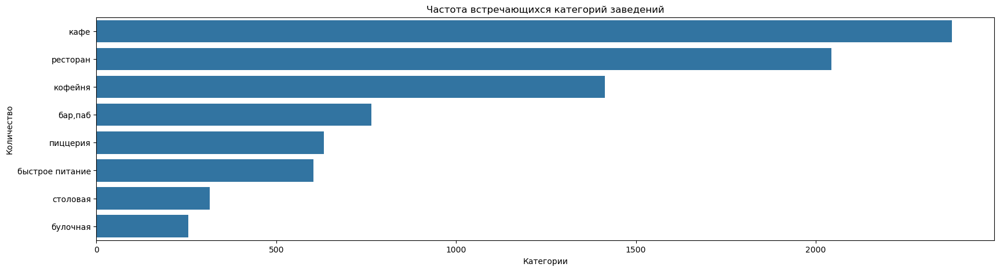

In [68]:
plt.figure(figsize=(20, 5))
sns.barplot(x='count', y='category', data=df_category_sort)
plt.xlabel('Категории')
plt.ylabel('Количество')
plt.title('Частота встречающихся категорий заведений')
plt.show()

#### Решение. Какие категории заведений представлены в данных.
- Наиболее часто встречаются кафе, рестораны и кофейни. Меньше всего встречаются булочные и столовые.

#### Задача.  количество посадочных мест в местах по категориям.

- Исследовать количество посадочных мест в местах по категориям: рестораны, кофейни, пиццерии, бары и так далее. Построить визуализации. Проанализировать результаты и сделать выводы.

In [69]:
df['seats'].mean()

108.42168925964546

In [70]:
df['seats'].min()

0.0

In [71]:
df.sort_values('seats', ascending=True).head(25)

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats,street,is_24_7
5578,мангал,быстрое питание,"Москва, Саянская улица, 11А,",Восточный административный округ,"ежедневно, круглосуточно",55.767800,37.833233,4.2,NaN,NaN,NaN,NaN,сетевой,0.0,Саянская улица,True
7271,вьет лотос,быстрое питание,"Москва, Поречная улица, 10,",Юго-Восточный административный округ,"ежедневно, 10:00–22:00",55.649476,37.771455,4.6,NaN,NaN,NaN,NaN,не сетевой,0.0,Поречная улица,False
7267,выдра кофе,кофейня,"Москва, Поречная улица, 10,",Юго-Восточный административный округ,"ежедневно, 10:00–22:00",55.650092,37.769662,5.0,NaN,NaN,NaN,NaN,не сетевой,0.0,Поречная улица,False
7266,шашлыкоff,"бар,паб","Москва, Поречная улица, 10,",Юго-Восточный административный округ,"пн-чт 10:00–00:00; пт,сб 10:00–03:00; вс 10:00...",55.650440,37.769901,4.4,средние,Средний счёт:500–700 ₽,600.0,NaN,сетевой,0.0,Поречная улица,False
7259,пицца паоло,пиццерия,"Москва, Коломенская улица, 19, корп. 2,",Южный административный округ,вт-вс 10:30–22:00,55.678245,37.695932,3.7,средние,Средний счёт:300–500 ₽,400.0,NaN,сетевой,0.0,Коломенская улица,False
2823,шаверма,быстрое питание,"Москва, Уссурийская улица, 1, корп. 5,",Восточный административный округ,"ежедневно, 09:00–22:00",55.823564,37.810661,3.0,NaN,NaN,NaN,NaN,сетевой,0.0,Уссурийская улица,False
2906,кофе с собой,кафе,"Москва, Сиреневый бульвар, 64А,",Восточный административный округ,"ежедневно, круглосуточно",55.802933,37.829503,3.5,NaN,Средний счёт:90–450 ₽,270.0,NaN,сетевой,0.0,Сиреневый бульвар,True
196,донер-шашлык,ресторан,"Москва, улица Лескова, 22,",Северо-Восточный административный округ,"ежедневно, круглосуточно",55.896962,37.608300,4.5,NaN,NaN,NaN,NaN,не сетевой,0.0,улица Лескова,True
7241,яндекс лавка,ресторан,"Москва, Варшавское шоссе, 59А,",Южный административный округ,"ежедневно, 07:00–02:00",55.675595,37.627051,4.0,NaN,NaN,NaN,NaN,сетевой,0.0,Варшавское шоссе,False
2973,шаурма,кафе,"Москва, бульвар Маршала Рокоссовского, 36/1,",Восточный административный округ,"ежедневно, 08:00–22:00",55.817703,37.714289,3.8,NaN,NaN,NaN,NaN,не сетевой,0.0,бульвар Маршала Рокоссовского,False


- Точки питания без сидящих мест. Вероятно точки с едой на вынос, где не предусмотрены места для сидения. Такие как шаурменные и кофейни.

In [72]:
df['seats'].max()

1288.0

In [73]:
df.sort_values('seats', ascending=False).head(25)

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats,street,is_24_7
6690,японская кухня,ресторан,"Москва, проспект Вернадского, 121, корп. 1,",Западный административный округ,NaN,55.657255,37.481547,4.4,NaN,NaN,NaN,NaN,сетевой,1288.0,проспект Вернадского,NaN
6518,delonixcafe,ресторан,"Москва, проспект Вернадского, 94, корп. 1,",Западный административный округ,"ежедневно, круглосуточно",55.652577,37.475730,4.1,высокие,Средний счёт:1500–2000 ₽,1750.0,NaN,не сетевой,1288.0,проспект Вернадского,True
6838,alternative coffee,кофейня,"Москва, проспект Вернадского, 41, стр. 1,",Западный административный округ,"пн-пт 09:00–21:00; сб,вс 09:00–22:00",55.673128,37.502992,4.3,NaN,NaN,NaN,NaN,не сетевой,1288.0,проспект Вернадского,False
6771,точка,кафе,"Москва, проспект Вернадского, 84, стр. 1,",Западный административный округ,NaN,55.665634,37.477830,4.7,NaN,NaN,NaN,NaN,сетевой,1288.0,проспект Вернадского,NaN
6684,пивной ресторан,"бар,паб","Москва, проспект Вернадского, 121, корп. 1,",Западный административный округ,NaN,55.657133,37.481508,4.5,NaN,NaN,NaN,NaN,не сетевой,1288.0,проспект Вернадского,NaN
6807,loft-cafe академия,кафе,"Москва, проспект Вернадского, 84, стр. 1,",Западный административный округ,пн-пт 09:00–20:00; сб 09:00–16:00,55.665142,37.478603,3.6,NaN,NaN,NaN,NaN,не сетевой,1288.0,проспект Вернадского,False
6658,гудбар,"бар,паб","Москва, проспект Вернадского, 97, корп. 1,",Западный административный округ,"пн-пт 11:00–23:00; сб,вс 13:00–23:00",55.667327,37.490601,4.1,средние,Средний счёт:700 ₽,700.0,NaN,не сетевой,1288.0,проспект Вернадского,False
6808,яндекс лавка,ресторан,"Москва, проспект Вернадского, 51, стр. 1,",Западный административный округ,"ежедневно, круглосуточно",55.672580,37.507753,4.0,NaN,NaN,NaN,NaN,сетевой,1288.0,проспект Вернадского,True
6641,one price coffee,кофейня,"Москва, проспект Вернадского, 84, стр. 1,",Западный административный округ,"ежедневно, 08:30–20:00",55.665129,37.478635,4.3,NaN,NaN,NaN,NaN,сетевой,1288.0,проспект Вернадского,False
6574,мюнгер,пиццерия,"Москва, проспект Вернадского, 97, корп. 1,",Западный административный округ,"пн-пт 08:00–21:00; сб,вс 10:00–21:00",55.667505,37.491001,4.8,NaN,NaN,NaN,NaN,сетевой,1288.0,проспект Вернадского,False


- 1200 мест выделяются, но похоже это торговые центры с общей площадкой под все точки, тем не менее это ошибкой не является, но так как они среднее размывают, то лучше будет считать по медиане.

In [74]:
df['seats'].median()

75.0

In [75]:
category_seats = df.groupby('category')['seats'].median().to_frame().reset_index().sort_values(by='seats', ascending=False)
category_seats

,category,seats
6,ресторан,86.0
0,"бар,паб",82.5
4,кофейня,80.0
7,столовая,75.5
2,быстрое питание,65.0
3,кафе,60.0
5,пиццерия,55.0
1,булочная,50.0


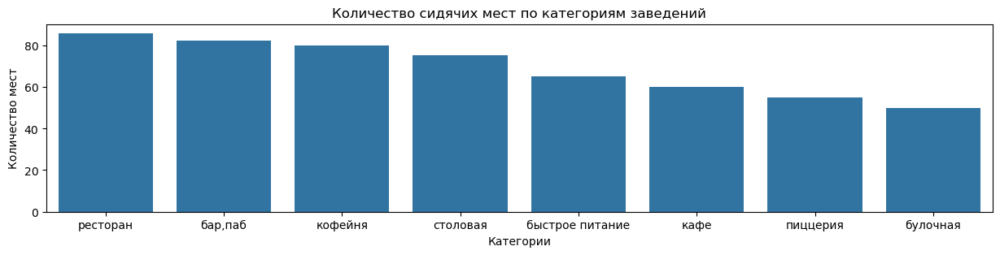

In [76]:
plt.figure(figsize=(15, 3))
sns.barplot(x='category', y='seats', data=category_seats)
plt.xlabel('Категории')
plt.ylabel('Количество мест')
plt.title('Количество сидячих мест по категориям заведений')
plt.show()

#### Решение.  количество посадочных мест в местах по категориям.
- Сидячих мест больше всего в ресторанах,  барах(пабах) и кофейнях что в полне ожидаемо так как люди приходят туда чтобы поесть и посидеть в комфорте. Меньше мест в булочных и пицерии. В булочных покупают выпечку для дома в основном. Пицерии больше специализуируются на доставку домой, поэтом много мест ждя них не критично.

#### Задача. Соотношение сетевых и несетевых заведений в датасете.

- Рассмотреть и изобразить соотношение сетевых и несетевых заведений в датасете. Каких заведений больше?

In [77]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8406 entries, 0 to 8405
Data columns (total 16 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   name               8406 non-null   object 
 1   category           8406 non-null   object 
 2   address            8406 non-null   object 
 3   district           8406 non-null   object 
 4   hours              7870 non-null   object 
 5   lat                8406 non-null   float64
 6   lng                8406 non-null   float64
 7   rating             8406 non-null   float64
 8   price              3315 non-null   object 
 9   avg_bill           3816 non-null   object 
 10  middle_avg_bill    3149 non-null   float64
 11  middle_coffee_cup  535 non-null    float64
 12  chain              8406 non-null   object 
 13  seats              4795 non-null   float64
 14  street             8406 non-null   object 
 15  is_24_7            7870 non-null   object 
dtypes: float64(6), object(10

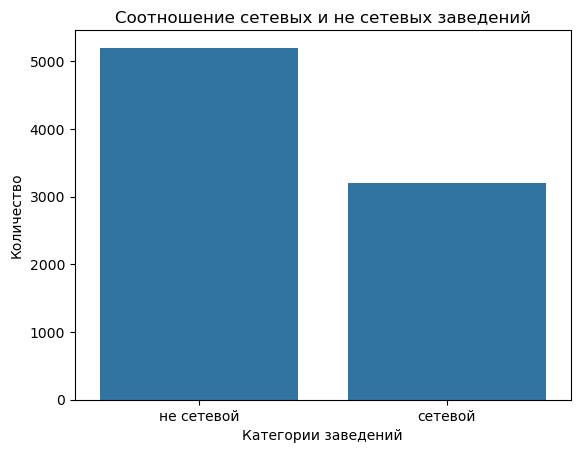

In [78]:
sns.countplot(x='chain', data=df)
plt.xlabel('Категории заведений')
plt.ylabel('Количество')
plt.title('Соотношение сетевых и не сетевых заведений')
plt.show()

#### Решение.  Соотношение сетевых и несетевых заведений в датасете.
- Не сетевые заведения встречаются чаще чем сетевые.

#### Задача. Какие категории заведений чаще являются сетевыми?

- Какие категории заведений чаще являются сетевыми? Исследовать данные и ответить на вопрос графиком.

In [79]:
df['chain'].value_counts()

chain
не сетевой    5201
сетевой       3205
Name: count, dtype: int64

In [80]:
data_chain = df.groupby(['category', 'chain'], \
                        as_index = False)[['name']].count()
data_chain

,category,chain,name
0,"бар,паб",не сетевой,596
1,"бар,паб",сетевой,169
2,булочная,не сетевой,99
3,булочная,сетевой,157
4,быстрое питание,не сетевой,371
5,быстрое питание,сетевой,232
6,кафе,не сетевой,1599
7,кафе,сетевой,779
8,кофейня,не сетевой,693
9,кофейня,сетевой,720


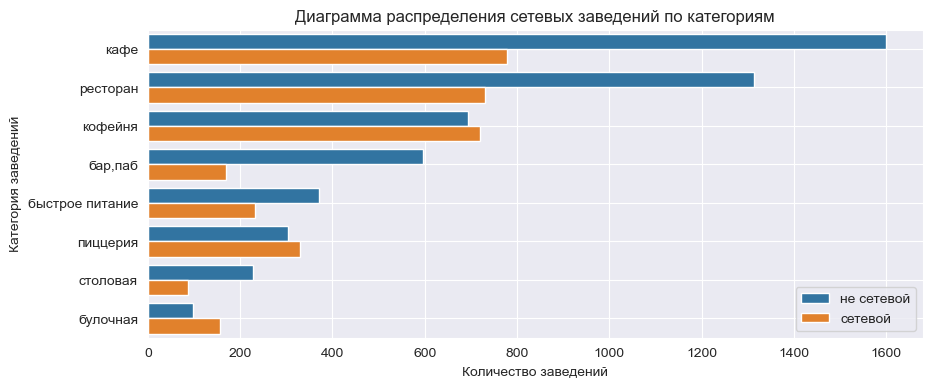

In [81]:
data_chain = df.groupby(['category', 'chain'], \
                        as_index = False)[['name']].count().sort_values(by='name', ascending=False)
sns.set_style('dark')
plt.figure(figsize=(10, 4))
sns.barplot(x='name', y='category', data=data_chain, hue='chain')
plt.title('Диаграмма распределения сетевых заведений по категориям')
plt.xlabel('Количество заведений')
plt.ylabel('Категория заведений')
plt.legend(loc='lower right', fontsize=10)
plt.grid()
plt.show()

#### Решение. Какие категории заведений чаще являются сетевыми?
- Сетевых заведений больше всего среди кафешек, так как в целом их чаще всего открывают. Но сети предпочитают делать из кофеин, пицерий и булочных, так как сетевых заведений в этих категориях больше чем не сетевых .

#### Задача. топ-15 популярных сетей в Москве.

- Сгруппировать данные по названиям заведений и найти топ-15 популярных сетей в Москве. Под популярностью понимается количество заведений этой сети в регионе. Построить подходящую для такой информации визуализацию. Знакомы ли эти сети? Есть ли какой-то признак, который их объединяет? К какой категории заведений они относятся?

In [82]:
df_chain_filter = df.query('chain == "сетевой"')
df_chain_filter

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats,street,is_24_7
4,иль марко,пиццерия,"Москва, Правобережная улица, 1Б,",Северный административный округ,"ежедневно, 10:00–22:00",55.881166,37.449357,5.0,средние,Средний счёт:400–600 ₽,500.0,NaN,сетевой,148.0,Правобережная улица,False
13,буханка,булочная,"Москва, Базовская улица, 15, корп. 1,",Северный административный округ,"ежедневно, 08:00–22:00",55.877007,37.504980,4.8,NaN,NaN,NaN,NaN,сетевой,180.0,Базовская улица,False
19,пекарня,булочная,"Москва, Ижорский проезд, 5,",Северный административный округ,"ежедневно, круглосуточно",55.887969,37.515688,4.4,NaN,NaN,NaN,NaN,сетевой,NaN,Ижорский проезд,True
20,чебуреки манты,кафе,"Москва, Правобережная улица, 1Б,",Северный административный округ,"ежедневно, 10:00–22:00",55.880287,37.448646,4.3,NaN,NaN,NaN,NaN,сетевой,148.0,Правобережная улица,False
23,буханка,булочная,"Москва, Лобненская улица, 13к2,",Северный административный округ,"ежедневно, 08:00–22:00",55.888421,37.527106,4.7,NaN,NaN,NaN,NaN,сетевой,NaN,Лобненская улица,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8317,беседка,кафе,"Москва, Кузьминская улица, 10,",Юго-Восточный административный округ,"ежедневно, 11:00–23:00",55.690691,37.787735,4.1,NaN,NaN,NaN,NaN,сетевой,NaN,Кузьминская улица,False
8340,семейный очаг,ресторан,"Москва, Шоссейная улица, 13,",Юго-Восточный административный округ,"ежедневно, 12:00–00:00",55.688104,37.725197,4.3,средние,Средний счёт:до 1000 ₽,1000.0,NaN,сетевой,98.0,Шоссейная улица,False
8372,чайхана sabr,ресторан,"Москва, улица Хлобыстова, 22,",Юго-Восточный административный округ,"ежедневно, 10:00–00:00",55.716361,37.813436,3.9,средние,Средний счёт:150–350 ₽,250.0,NaN,сетевой,32.0,улица Хлобыстова,False
8379,лагман хаус,кафе,"Москва, Новороссийская улица, 14, стр. 2,",Юго-Восточный административный округ,"ежедневно, 10:00–00:00",55.678772,37.759422,4.3,NaN,NaN,NaN,NaN,сетевой,40.0,Новороссийская улица,False


In [83]:
df_top_chain = df_chain_filter['name'].value_counts().head(15).to_frame().reset_index()
df_top_chain

,name,count
0,шоколадница,120
1,домино'с пицца,76
2,додо пицца,74
3,one price coffee,71
4,яндекс лавка,69
5,cofix,65
6,prime,50
7,хинкальная,44
8,кофепорт,42
9,кулинарная лавка братьев караваевых,39


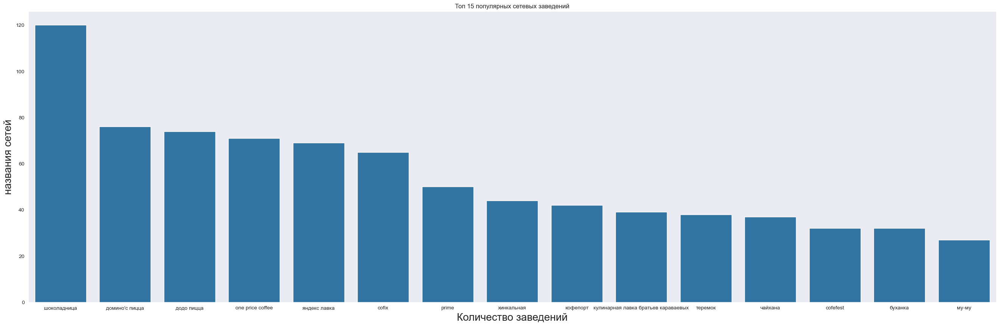

In [84]:
plt.figure(figsize=(33, 10))
sns.barplot(x='name', y='count', data=df_top_chain)
plt.title('Топ 15 популярных сетевых заведений')
plt.xlabel('Количество заведений', fontsize=20)
plt.ylabel('названия сетей', fontsize=20)
plt.show()

#### Задача. топ-15 популярных сетей в Москве.
- На первых местах Шоколадница и Пицерии доминос с додо
Общий признак - есть доставка на дом.
Категории попавшие в топ например: шоколадница - кафетерий, яндекс лавка и prime - рестораны, домино и додо -пицерии, one price coffee и cofix -кофейни, буханка - булочная, му-му вообще позицинирует в разных заведениях себя по разному. Очень разнообразные категории получившие громкое имя и пользующиеся спросом.
Кофейни встречаются чаще.
Почти все заведения на слуху и довольно часто попадаются на глаза.

In [85]:
df_without_unknown = df.query('name != "не известно"')

In [86]:
data_category_name = df_without_unknown.groupby(['category', 'name'], \
                        as_index = False)[['street']].count().sort_values(by='street', ascending = False).head(15).reset_index()
data_category_name

,index,category,name,street
0,3810,кофейня,шоколадница,119
1,4006,пиццерия,домино'с пицца,77
2,4002,пиццерия,додо пицца,74
3,3302,кофейня,one price coffee,72
4,5710,ресторан,яндекс лавка,69
5,3142,кофейня,cofix,65
6,4509,ресторан,prime,49
7,3608,кофейня,кофепорт,42
8,2219,кафе,кулинарная лавка братьев караваевых,39
9,5470,ресторан,теремок,36


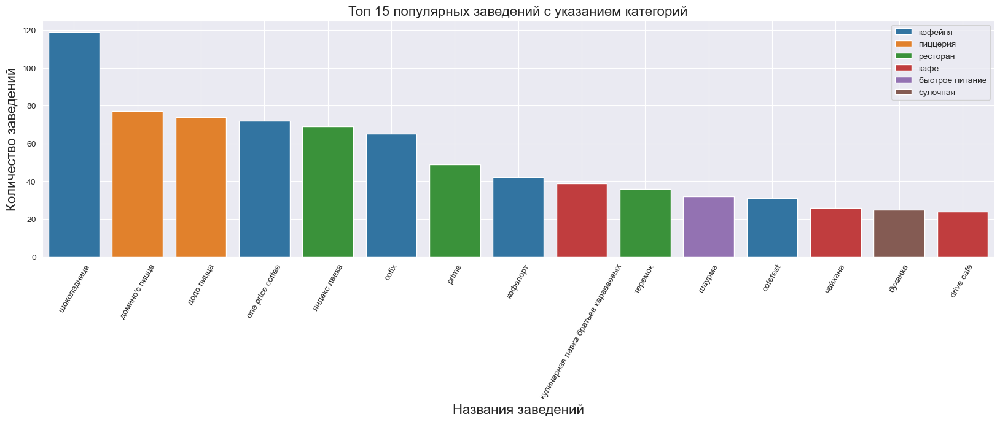

In [87]:
sns.set_style('dark')
plt.figure(figsize=(20, 5))
sns.barplot(x='name', y='street', data=data_category_name, hue='category')
plt.title('Топ 15 популярных заведений с указанием категорий', fontsize=16)
plt.xlabel('Названия заведений', fontsize=16)
plt.ylabel('Количество заведений', fontsize=16)
plt.legend(loc='upper right', fontsize=10)
plt.xticks(rotation=60)
plt.grid()
plt.show()


- Из пятнадцати самых популярных заведений 5 из них кофейни, му-му и хинкальня пропал из рейтинга по причине заведений разных направленностей, но под одной франшизой.

#### Задача. Какие административные районы Москвы присутствуют в датасете?

- Какие административные районы Москвы присутствуют в датасете? Отобразить общее количество заведений и количество заведений каждой категории по районам. Попробовать проиллюстрировать эту информацию одним графиком.

In [88]:
data_district = df.groupby(['category', 'district'], \
                        as_index = False)[['name']].count()
data_district

,category,district,name
0,"бар,паб",Восточный административный округ,53
1,"бар,паб",Западный административный округ,50
2,"бар,паб",Северный административный округ,68
3,"бар,паб",Северо-Восточный административный округ,63
4,"бар,паб",Северо-Западный административный округ,23
...,...,...,...
67,столовая,Северо-Западный административный округ,18
68,столовая,Центральный административный округ,66
69,столовая,Юго-Восточный административный округ,25
70,столовая,Юго-Западный административный округ,17


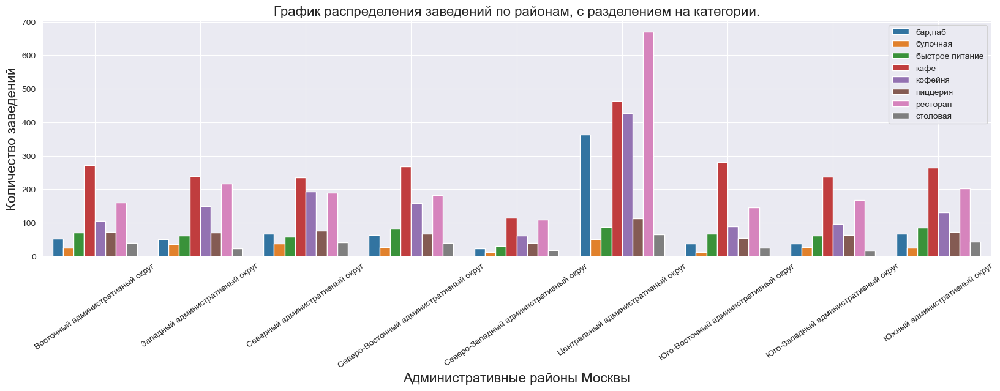

In [89]:
data_district = df.groupby(['category', 'district'], \
                        as_index = False)[['name']].count()
sns.set_style('dark')
plt.figure(figsize=(20, 5))
sns.barplot(x='district', y='name', data=data_district, hue='category')
plt.title('График распределения заведений по районам, с разделением на категории.', fontsize=16)
plt.xlabel('Административные районы Москвы', fontsize=16)
plt.ylabel('Количество заведений', fontsize=16)
plt.legend(loc='upper right', fontsize=10)
plt.xticks(rotation=35)
plt.grid()
plt.show()

#### Решение. Какие административные районы Москвы присутствуют в датасете?
- По графику видно, что распределение категорий заведений от района к району выравнено исключая центральный округ и северо_западный округ. В северо_западном почти в двое меньше заведений по сравнению сдругими районами. В центральном напротив, открытых заведений значительно больше, особенно выделяются четыре категории заведений: это рестораны, кафе, кофейни и бары(пабы) и ресторанов почти в 3 раза больше чем в любом другом округе.

#### Задача.   распределение средних рейтингов по категориям заведений.

- Визуализировать распределение средних рейтингов по категориям заведений. Сильно ли различаются усреднённые рейтинги в разных типах общепита?

In [90]:
category_rating = df.groupby('category')['rating'].mean().round(decimals=2).to_frame().reset_index()
sort_category_rating = category_rating.sort_values(by='rating', ascending=False)
sort_category_rating

,category,rating
0,"бар,паб",4.39
5,пиццерия,4.30
6,ресторан,4.29
4,кофейня,4.28
1,булочная,4.27
7,столовая,4.21
3,кафе,4.12
2,быстрое питание,4.05


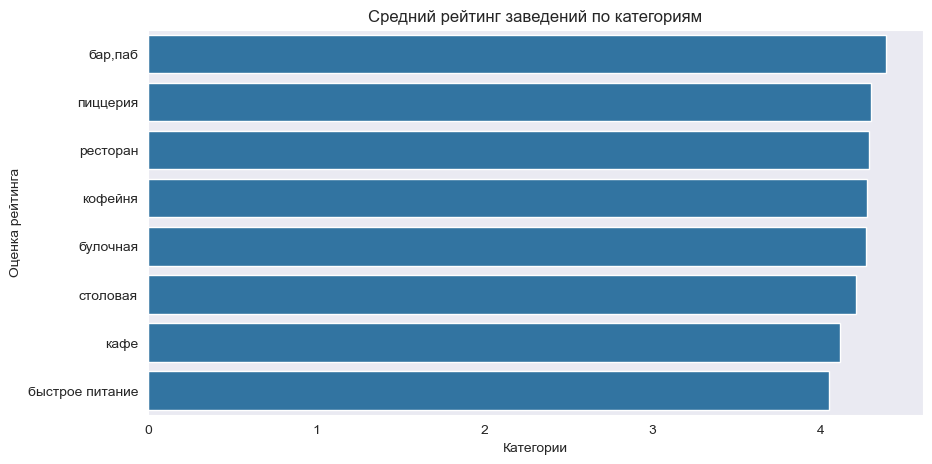

In [91]:
plt.figure(figsize=(10, 5))
sns.barplot(x='rating', y='category', data=sort_category_rating)
plt.xlabel('Категории')
plt.ylabel('Оценка рейтинга')
plt.title('Средний рейтинг заведений по категориям')
plt.show()

#### Решение.   распределение средних рейтингов по категориям заведений.
- Средний рейтинг выше у баров(пабов) самый низкий у заведений быстрого питания. Ниже 4х балов по пятибальной шкале ни одна из категорий не опускается

#### Задача. Построить фоновую картограмму (хороплет) со средним рейтингом заведений каждого района.

- Построить фоновую картограмму (хороплет) со средним рейтингом заведений каждого района.

In [92]:
rating_map = df.groupby('district', as_index=False)['rating'].agg('mean')
rating_map

,district,rating
0,Восточный административный округ,4.174185
1,Западный административный округ,4.181551
2,Северный административный округ,4.239778
3,Северо-Восточный административный округ,4.148260
4,Северо-Западный административный округ,4.208802
5,Центральный административный округ,4.377520
6,Юго-Восточный административный округ,4.101120
7,Юго-Западный административный округ,4.172920
8,Южный административный округ,4.184417


In [93]:
# подключаем модуль для работы с JSON-форматом
import json

# читаем файл и сохраняем в переменной
with open(r"C:\Users\SubKi\Downloads\data_sets\admin_level_geomap.geojson", 'r', encoding='utf-8') as f: 
    geo_json = json.load(f)


In [94]:
# импортируем карту и хороплет
from folium import Map, Choropleth

# загружаем JSON-файл с границами округов Москвы
state_geo = geo_json
# moscow_lat - широта центра Москвы, moscow_lng - долгота центра Москвы
moscow_lat, moscow_lng = 55.751244, 37.618423

# создаём карту Москвы
m = Map(location=[moscow_lat, moscow_lng], zoom_start=10, tiles='Cartodb Positron')

# создаём хороплет с помощью конструктора Choropleth и добавляем его на карту
Choropleth(
    geo_data=state_geo,
    data=rating_map,
    columns=['district', 'rating'],
    key_on='feature.name',
    fill_color='YlOrRd',
    fill_opacity=0.4,
    legend_name='Средний рейтинг заведений по районам',
).add_to(m)

# выводим карту
m

#### Решение. Построить фоновую картограмму (хороплет) со средним рейтингом заведений каждого района.
- Хороплёт построен. По карте видно что средний рейтинг выше в центральном окргуе, а самый низкий в юго-восточном округе. 

#### Задача. Отобразить все заведения датасета на карте с помощью кластеров.

- Отобразить все заведения датасета на карте с помощью кластеров средствами библиотеки folium.

In [95]:
# импортируем карту и маркер
from folium import Map, Marker
# импортируем кластер
from folium.plugins import MarkerCluster
m2 = Map(location=[moscow_lat, moscow_lng], zoom_start=10, tiles='Cartodb Positron')
# создаём пустой кластер, добавляем его на карту
marker_cluster = MarkerCluster().add_to(m2)

# пишем функцию, которая принимает строку датафрейма,
# создаёт маркер в текущей точке и добавляет его в кластер marker_cluster
def create_clusters(row):
    Marker(
        [row['lat'], row['lng']],
        popup=f"{row['name']} {row['rating']}",
    ).add_to(marker_cluster)

# применяем функцию create_clusters() к каждой строке датафрейма
df.apply(create_clusters, axis=1)

# выводим карту
m2

#### Решение. Отобразить все заведения датасета на карте с помощью кластеров 
- Задача выполнена, все заведения отображаются на карте вместе с рейтингом и названием.

#### Задача. Найти топ-15 улиц по количеству заведений.

- Найти топ-15 улиц по количеству заведений. Построить график распределения количества заведений и их категорий по этим улицам. Попробовать проиллюстрировать эту информацию одним графиком.

In [96]:
df_top_street = df['street'].value_counts().head(15).to_frame().reset_index()
df_top_street.columns = ['street', 'count']
df_top_street

,street,count
0,проспект Мира,184
1,Профсоюзная улица,122
2,проспект Вернадского,108
3,Ленинский проспект,107
4,Ленинградский проспект,95
5,Дмитровское шоссе,88
6,Каширское шоссе,77
7,Варшавское шоссе,76
8,Ленинградское шоссе,70
9,МКАД,65


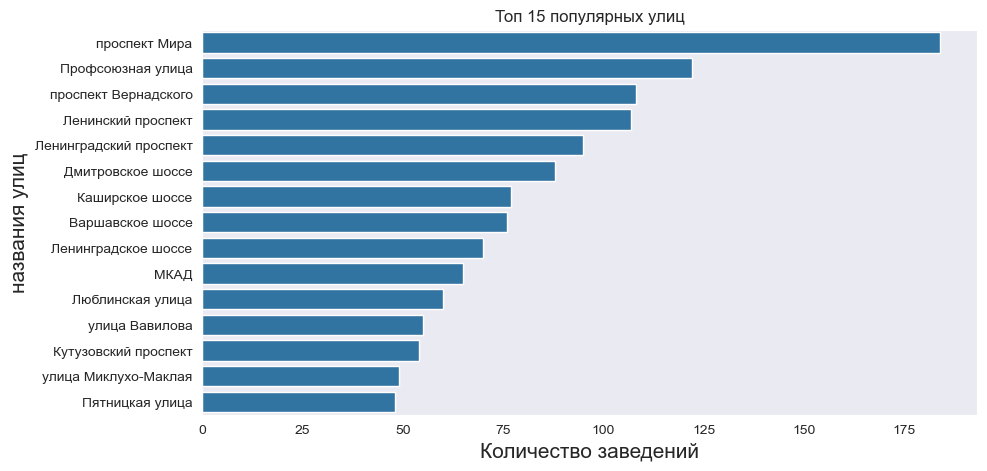

In [97]:
plt.figure(figsize=(10, 5))
sns.barplot(x='count', y='street', data=df_top_street)
plt.title('Топ 15 популярных улиц')
plt.xlabel('Количество заведений', fontsize=15)
plt.ylabel('названия улиц', fontsize=15)
plt.show()

In [98]:
filtered_df_top_street = df[df['street'].isin(df_top_street['street'])]
filtered_df_top_street

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats,street,is_24_7
8,donna maria,ресторан,"Москва, Дмитровское шоссе, 107, корп. 4,",Северный административный округ,"ежедневно, 10:00–22:00",55.880045,37.539006,4.8,средние,Средний счёт:от 500 ₽,500.0,NaN,не сетевой,79.0,Дмитровское шоссе,False
12,заправка,кафе,"Москва, МКАД, 80-й километр, 1,",Северный административный округ,вт-сб 09:00–18:00,55.899938,37.517958,4.3,средние,Средний счёт:330 ₽,330.0,NaN,не сетевой,NaN,МКАД,False
17,чайхана беш-бармак,ресторан,"Москва, Ленинградское шоссе, 71Б, стр. 2,",Северный административный округ,"ежедневно, круглосуточно",55.876908,37.449876,4.4,средние,Средний счёт:350–500 ₽,425.0,NaN,не сетевой,96.0,Ленинградское шоссе,True
26,пикочино,пиццерия,"Москва, Дмитровское шоссе, 107к2,",Северный административный округ,"пн-чт 11:00–22:00; пт,сб 11:00–23:00; вс 11:00...",55.879390,37.541228,4.5,средние,Средний счёт:300–1500 ₽,900.0,NaN,не сетевой,NaN,Дмитровское шоссе,False
28,mafe,кафе,"Москва, МКАД, 78-й километр, 14к1,",Северный административный округ,"ежедневно, 10:00–19:00",55.893061,37.501319,3.8,средние,Средний счёт:400–600 ₽,500.0,NaN,не сетевой,NaN,МКАД,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8356,назис пури,кофейня,"Москва, Люблинская улица, 61,",Юго-Восточный административный округ,"ежедневно, 09:00–22:00",55.684103,37.738588,4.5,NaN,NaN,NaN,NaN,не сетевой,NaN,Люблинская улица,False
8396,пекинский двор,ресторан,"Москва, Ленинский проспект, 158,",Западный административный округ,"ежедневно, 11:00–23:00",55.651706,37.482667,4.3,выше среднего,Средний счёт:1000–1500 ₽,1250.0,NaN,не сетевой,200.0,Ленинский проспект,False
8401,суши мания,кафе,"Москва, Профсоюзная улица, 56,",Юго-Западный административный округ,"ежедневно, 09:00–02:00",55.670021,37.552480,4.4,NaN,NaN,NaN,NaN,не сетевой,86.0,Профсоюзная улица,False
8403,самовар,кафе,"Москва, Люблинская улица, 112А, стр. 1,",Юго-Восточный административный округ,"ежедневно, круглосуточно",55.648859,37.743219,3.9,NaN,Средний счёт:от 150 ₽,150.0,NaN,не сетевой,150.0,Люблинская улица,True


In [99]:
data_street = filtered_df_top_street.groupby(['street', 'category'], \
                        as_index = False)[['name']].count()
data_street

,street,category,name
0,Варшавское шоссе,"бар,паб",6
1,Варшавское шоссе,быстрое питание,7
2,Варшавское шоссе,кафе,18
3,Варшавское шоссе,кофейня,14
4,Варшавское шоссе,пиццерия,4
...,...,...,...
106,улица Миклухо-Маклая,быстрое питание,4
107,улица Миклухо-Маклая,кафе,21
108,улица Миклухо-Маклая,кофейня,4
109,улица Миклухо-Маклая,пиццерия,2


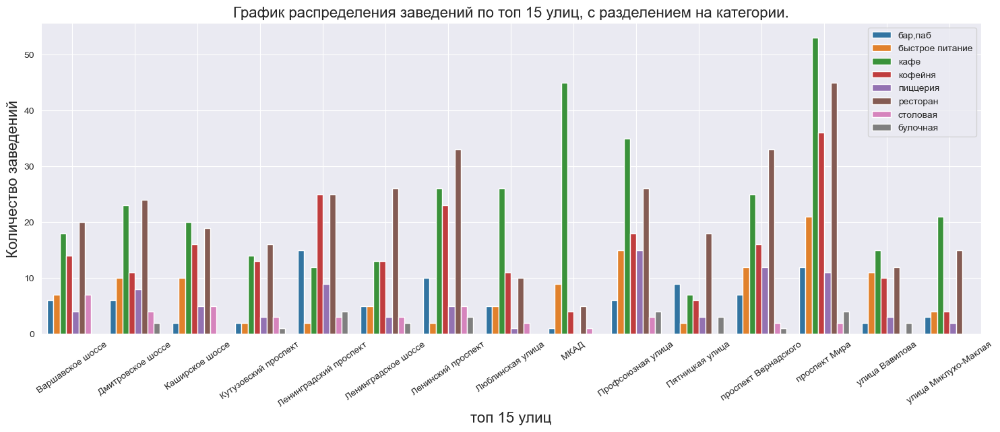

In [100]:
sns.set_style('dark')
plt.figure(figsize=(18, 6))
sns.barplot(x= 'street', y= 'name', data=data_street, hue='category')
plt.title('График распределения заведений по топ 15 улиц, с разделением на категории.', fontsize=16)
plt.xlabel('топ 15 улиц', fontsize=16)
plt.ylabel('Количество заведений', fontsize=16)
plt.legend(loc='upper right', fontsize=10)
plt.xticks(rotation=35)
plt.grid()
plt.show()

#### Решение. Найти топ-15 улиц по количеству заведений 
- Найдены топ-15 улиц по количеству заведений  и построен график с категориями заведений.

#### Задача. Найти улицы, на которых находится только один объект общепита

- Найти улицы, на которых находится только один объект общепита. Что можно сказать об этих заведениях?

In [101]:
df_bot_street = df['street'].value_counts().to_frame().reset_index()
df_bot_street.columns = ['street', 'count']
df_bot_street

,street,count
0,проспект Мира,184
1,Профсоюзная улица,122
2,проспект Вернадского,108
3,Ленинский проспект,107
4,Ленинградский проспект,95
...,...,...
1443,улица Маршала Соколовского,1
1444,Малый Казённый переулок,1
1445,улица Максимова,1
1446,Басманный тупик,1


In [102]:
def create_categories(row):
     if row['count'] > 1:
        return 'больше одного заведения'
     else:
        return 'одно заведение'

# Предположим, у вас есть DataFrame df
df_bot_street['prevalence'] = df_bot_street.apply(create_categories, axis=1)
df_bot_street.columns = ['street', 'count', 'prevalence']
df_bot_street

,street,count,prevalence
0,проспект Мира,184,больше одного заведения
1,Профсоюзная улица,122,больше одного заведения
2,проспект Вернадского,108,больше одного заведения
3,Ленинский проспект,107,больше одного заведения
4,Ленинградский проспект,95,больше одного заведения
...,...,...,...
1443,улица Маршала Соколовского,1,одно заведение
1444,Малый Казённый переулок,1,одно заведение
1445,улица Максимова,1,одно заведение
1446,Басманный тупик,1,одно заведение


In [103]:
df_bot_street['street'].count()

1448

In [104]:
df_bot_street['prevalence'].value_counts()

prevalence
больше одного заведения    990
одно заведение             458
Name: count, dtype: int64

In [105]:
merged_df = pd.merge(df, df_bot_street, on='street')
df['is_24_7'] = df['is_24_7'].replace({True: 'круглосуточно', False: 'не круглосуточно'})
merged_df.drop(['lat', 'lng', 'address', 'count', 'is_24_7'], axis=1, inplace=True)
merged_df

,name,category,district,hours,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats,street,prevalence
0,wowфли,кафе,Северный административный округ,"ежедневно, 10:00–22:00",5.0,NaN,NaN,NaN,NaN,не сетевой,NaN,улица Дыбенко,больше одного заведения
1,четыре комнаты,ресторан,Северный административный округ,"ежедневно, 10:00–22:00",4.5,выше среднего,Средний счёт:1500–1600 ₽,1550.0,NaN,не сетевой,4.0,улица Дыбенко,больше одного заведения
2,хазри,кафе,Северный административный округ,"пн-чт 11:00–02:00; пт,сб 11:00–05:00; вс 11:00...",4.6,средние,Средний счёт:от 1000 ₽,1000.0,NaN,не сетевой,45.0,Клязьминская улица,больше одного заведения
3,dormouse coffee shop,кофейня,Северный административный округ,"ежедневно, 09:00–22:00",5.0,NaN,Цена чашки капучино:155–185 ₽,NaN,170.0,не сетевой,NaN,улица Маршала Федоренко,больше одного заведения
4,иль марко,пиццерия,Северный административный округ,"ежедневно, 10:00–22:00",5.0,средние,Средний счёт:400–600 ₽,500.0,NaN,сетевой,148.0,Правобережная улица,больше одного заведения
...,...,...,...,...,...,...,...,...,...,...,...,...,...
8401,суши мания,кафе,Юго-Западный административный округ,"ежедневно, 09:00–02:00",4.4,NaN,NaN,NaN,NaN,не сетевой,86.0,Профсоюзная улица,больше одного заведения
8402,миславнес,кафе,Южный административный округ,"ежедневно, 08:00–22:00",4.8,NaN,NaN,NaN,NaN,не сетевой,150.0,Пролетарский проспект,больше одного заведения
8403,самовар,кафе,Юго-Восточный административный округ,"ежедневно, круглосуточно",3.9,NaN,Средний счёт:от 150 ₽,150.0,NaN,не сетевой,150.0,Люблинская улица,больше одного заведения
8404,чайхана sabr,кафе,Юго-Восточный административный округ,"ежедневно, круглосуточно",4.2,NaN,NaN,NaN,NaN,сетевой,150.0,Люблинская улица,больше одного заведения


In [106]:
df.columns

Index(['name', 'category', 'address', 'district', 'hours', 'lat', 'lng',
       'rating', 'price', 'avg_bill', 'middle_avg_bill', 'middle_coffee_cup',
       'chain', 'seats', 'street', 'is_24_7'],
      dtype='object')

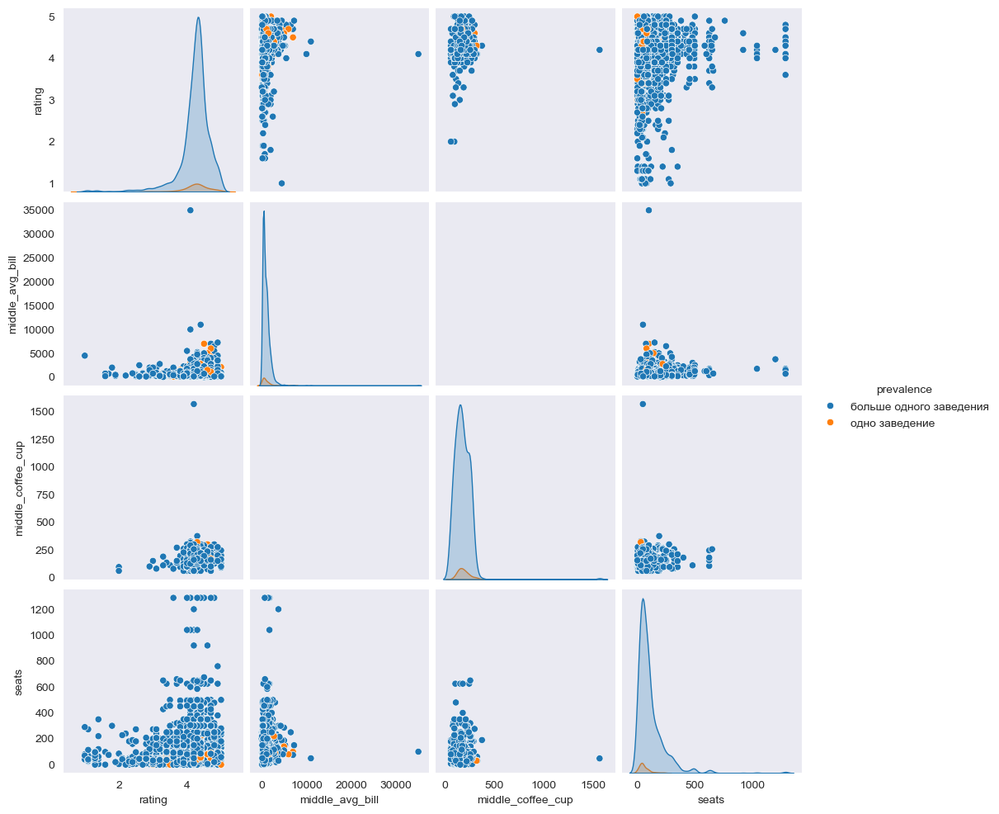

In [107]:
sns.pairplot(merged_df, hue='prevalence') 


- Все значения таких мест довольнго усредненые, ничего выдающегося нет. Рейтинг от 3 до 5, средний чек в пределах 2 тысяч рублей, сидячие мест в пределах 250, чашка кофе в пределах 250 рублей.

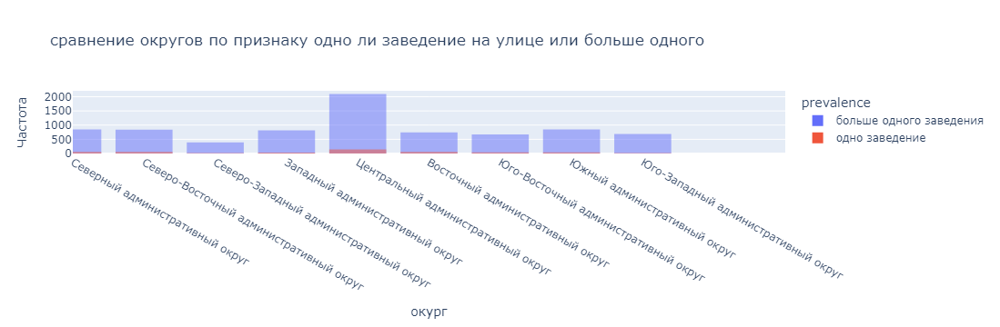

In [108]:
# строим гистограммы
fig = px.histogram(merged_df, # загружаем данные
                   x='district', # указываем столбец с данными для оси X
                   color='prevalence', # обозначаем категорию для разделения цветом
                   range_x=[0, 10], # ограничиваем ось X
                   title='сравнение округов по признаку одно ли заведение на улице или больше одного ', # указываем заголовок
                   nbins=10, # назначаем число корзин
                   barmode='overlay') # выбираем «полупрозрачный» тип отображения столбцов
fig.update_xaxes(title_text='окург') # подпись для оси X
fig.update_yaxes(title_text='Частота') # подпись для оси Y
fig.show() # выводим график

в каждом округе есть около 50 таких улиц с одним заведением кроме центрально там таких улиц 145.

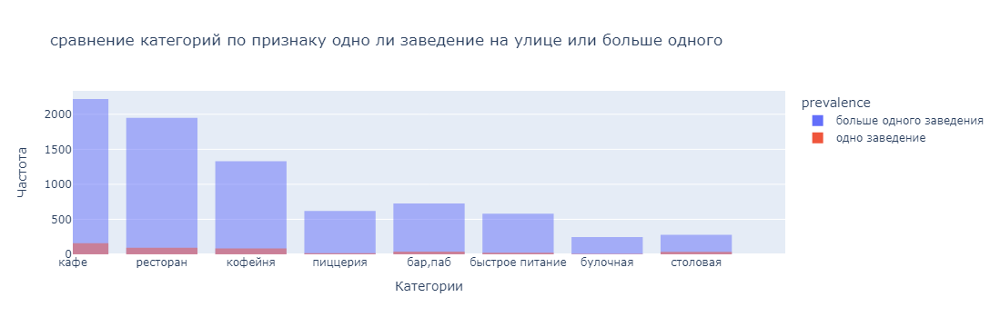

In [109]:
# строим гистограммы
fig = px.histogram(merged_df, # загружаем данные
                   x='category', # указываем столбец с данными для оси X
                   color='prevalence', # обозначаем категорию для разделения цветом
                   range_x=[0, 8], # ограничиваем ось X
                   title='сравнение категорий по признаку одно ли заведение на улице или больше одного ', # указываем заголовок
                   nbins=10, # назначаем число корзин
                   barmode='overlay') # выбираем «полупрозрачный» тип отображения столбцов
fig.update_xaxes(title_text='Категории') # подпись для оси X
fig.update_yaxes(title_text='Частота') # подпись для оси Y
fig.show() # выводим график

Чаще всего на таких улицах кафе(160), рестораны(93) и кофейни(84)

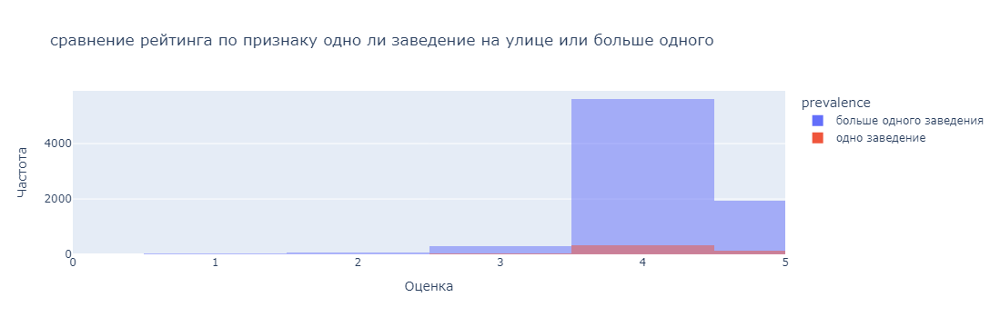

In [110]:
# строим гистограммы
fig = px.histogram(merged_df, # загружаем данные
                   x='rating', # указываем столбец с данными для оси X
                   color='prevalence', # обозначаем категорию для разделения цветом
                   range_x=[0, 5], # ограничиваем ось X
                   title='сравнение рейтинга по признаку одно ли заведение на улице или больше одного ', # указываем заголовок
                   nbins=5, # назначаем число корзин
                   barmode='overlay') # выбираем «полупрозрачный» тип отображения столбцов
fig.update_xaxes(title_text='Оценка') # подпись для оси X
fig.update_yaxes(title_text='Частота') # подпись для оси Y
fig.show() # выводим график

В основном рейтинг заведений 4 и5 балов.

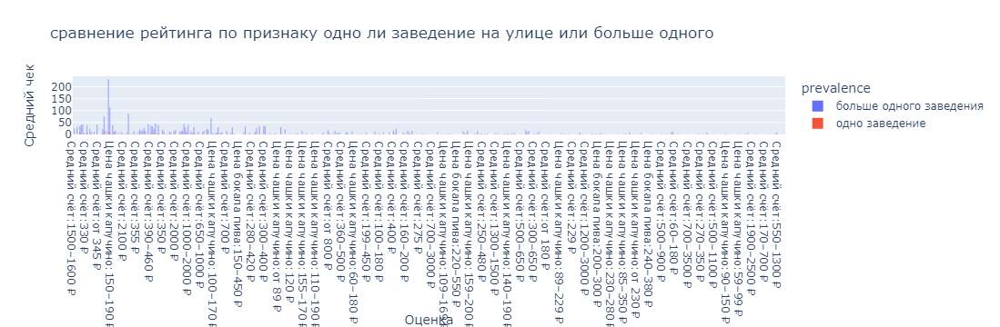

In [111]:
# строим гистограммы
fig = px.histogram(merged_df, # загружаем данные
                   x='avg_bill', # указываем столбец с данными для оси X
                   color='prevalence', # обозначаем категорию для разделения цветом
                   range_x=[0, 500], # ограничиваем ось X
                   title='сравнение рейтинга по признаку одно ли заведение на улице или больше одного ', # указываем заголовок
                   nbins=500, # назначаем число корзин
                   barmode='overlay') # выбираем «полупрозрачный» тип отображения столбцов
fig.update_xaxes(title_text='Оценка') # подпись для оси X
fig.update_yaxes(title_text='Средний чек') # подпись для оси Y
fig.show() # выводим график

Средний счёт в пределах 2000 рублей

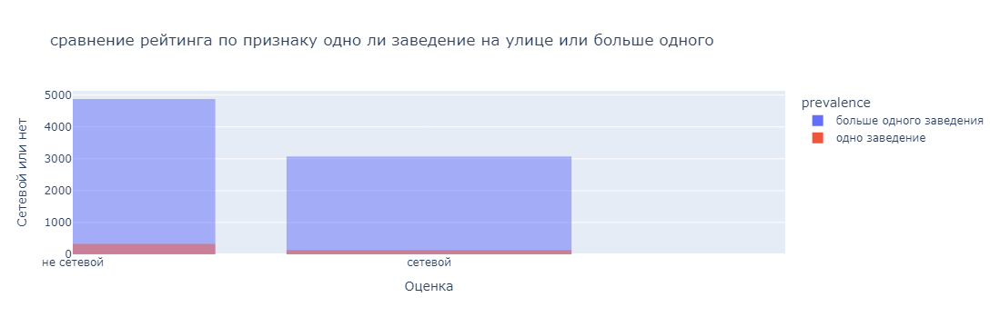

In [112]:
# строим гистограммы
fig = px.histogram(merged_df, # загружаем данные
                   x='chain', # указываем столбец с данными для оси X
                   color='prevalence', # обозначаем категорию для разделения цветом
                   range_x=[0, 2], # ограничиваем ось X
                   title='сравнение рейтинга по признаку одно ли заведение на улице или больше одного ', # указываем заголовок
                   nbins=2, # назначаем число корзин
                   barmode='overlay') # выбираем «полупрозрачный» тип отображения столбцов
fig.update_xaxes(title_text='Оценка') # подпись для оси X
fig.update_yaxes(title_text='Сетевой или нет') # подпись для оси Y
fig.show() # выводим график

Не сетвых больше в два с половиной раза чем сетевых

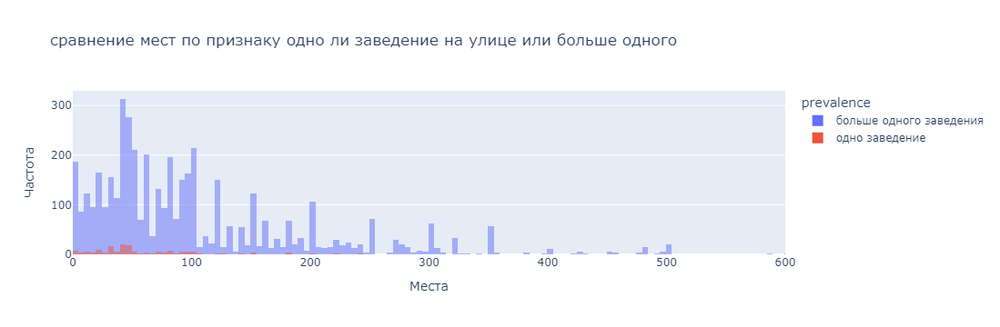

In [113]:
# строим гистограммы
fig = px.histogram(merged_df, # загружаем данные
                   x='seats', # указываем столбец с данными для оси X
                   color='prevalence', # обозначаем категорию для разделения цветом
                   range_x=[0, 600], # ограничиваем ось X
                   title='сравнение мест по признаку одно ли заведение на улице или больше одного ', # указываем заголовок
                   nbins=600, # назначаем число корзин
                   barmode='overlay') # выбираем «полупрозрачный» тип отображения столбцов
fig.update_xaxes(title_text='Места') # подпись для оси X
fig.update_yaxes(title_text='Частота') # подпись для оси Y
fig.show() # выводим график

- Мест не больше 250, и в основном около 50 мест в заведении. в каждом округе есть около 50 таких улиц с одним заведением кроме центрально там таких улиц 145.

#### Решение. Найти улицы, на которых находится только один объект общепита.
- Были найдены улицы с одним заведениме и также был проведён анализ на общие зависимости таких заведений.
    Улиц с всего одним заведением всего 458, это в 3 раза меньше чем улиц где таких заведений больше одного.
Все эти заведения похожи друг на друга: средний чек — около 2 тысяч рублей, количество сидячих мест — примерно 250, стоимость чашки кофе — около 250 рублей.

В каждом округе есть примерно 50 таких улиц, где расположено одно заведение. В центре таких улиц 145. Чаще всего на таких улицах встречаются кафе (160), рестораны (93) и кофейни (84). Средний рейтинг заведений — 4 или 5 баллов. Не сетевых заведений в два с половиной раза больше, чем сетевых. Количество мест в заведениях обычно не превышает 250, а чаще всего это около 50 мест.


#### задача. Посчитать медиану столбца middle_avg_bill для каждого района. Используйте это значение в качестве ценового индикатора района. Построить фоновую картограмму (хороплет) с полученными значениями для каждого района.

- Значения средних чеков заведений хранятся в столбце middle_avg_bill. Эти числа показывают примерную стоимость заказа в рублях, которая чаще всего выражена диапазоном. Посчитать медиану этого столбца для каждого района. Используйте это значение в качестве ценового индикатора района. Построить фоновую картограмму (хороплет) с полученными значениями для каждого района. Проанализировать цены в центральном административном округе и других. Как удалённость от центра влияет на цены в заведениях?

In [114]:
df['middle_avg_bill'].head()

0       NaN
1    1550.0
2    1000.0
3       NaN
4     500.0
Name: middle_avg_bill, dtype: float64

In [115]:
df_disrict_bill_map = df.groupby('district')['middle_avg_bill'].median().to_frame().reset_index()
df_disrict_bill_map

,district,middle_avg_bill
0,Восточный административный округ,575.0
1,Западный административный округ,1000.0
2,Северный административный округ,650.0
3,Северо-Восточный административный округ,500.0
4,Северо-Западный административный округ,700.0
5,Центральный административный округ,1000.0
6,Юго-Восточный административный округ,450.0
7,Юго-Западный административный округ,600.0
8,Южный административный округ,500.0


In [116]:
m3 = Map(location=[moscow_lat, moscow_lng], zoom_start=10, tiles='Cartodb Positron')
Choropleth(
    geo_data=state_geo,
    data=df_disrict_bill_map,
    columns=['district', 'middle_avg_bill'],
    key_on='feature.name',
    fill_color='YlOrRd',
    fill_opacity=0.5,
    legend_name='Медианый чек заведений по районам',
).add_to(m3)

# выводим карту
m3

#### Решение. Посчитать медиану столбца middle_avg_bill для каждого района. Используйте это значение в качестве ценового индикатора района. Построить фоновую картограмму (хороплет) с полученными значениями для каждого района.
- Медиана среднего чека по районам подсчитана и хороплёт построен. Исходя из визуализации В центре и западном административном округе либо самые дорогие завдения или же там больше готовы тратить при посещении. В остальных сильно заметно что медианные значения среднего чека значительно ниже.

#### промежуточный общий вывод.
- Наиболее часто встречаются кафе, рестораны и кофейни. Меньше всего встречаются булочные и столовые.
- Сидячих мест больше всего в ресторанах, барах(пабах) и кофейнях что в полне ожидаемо так как люди приходят туда чтобы поесть и посидеть в комфорте. Меньше мест в булочных и пицерии. В булочных покупают выпечку для дома в основном. Пицерии больше специализуируются на доставку домой, поэтом много мест ждя них не критично.
- Не сетевые заведения встречаются чаще чем сетевые.
- Сетевых заведений больше всего среди кафешек, так как в целом их чаще всего открывают. Но сети предпочитают делать из кофеин, пицерий и булочных, так как сетевых заведений в этих категориях больше чем не сетевых.
- топ-15 популярных сетей в Москве. на первых местах Шоколадница и Пицерии доминос с додо Общий признак - есть доставка на дом. Категории попавшие в топ например: шоколадница - кафетерий, яндекс лавка и prime - рестораны, домино и додо -пицерии, one price coffee и cofix -кофейни, буханка - булочная, му-му вообще позицинирует в разных заведениях себя по разному. Очень разнообразные категории получившие громкое имя и пользующиеся спросом. Кофейни встречаются чаще. Почти все заведения на слуху и довольно часто попадаются на глаза.
- По графику видно, что распределение категорий заведений от района к району выравнено исключая центральный округ и северо_западный округ. В северо_западном почти в двое меньше заведений по сравнению сдругими районами. В центральном напротив, открытых заведений значительно больше, особенно выделяются четыре категории заведений: это рестораны, кафе, кофейни и бары(пабы) и ресторанов почти в 3 раза больше чем в любом другом округе.
- Средний рейтинг выше у баров(пабов) самый низкий у заведений быстрого питания. Ниже 4х балов по пятибальной шкале ни одна из категорий не опускается
- На улицах с наибольшим количеством заведений, лидируют кафе, кофейни и рестораны. Булочных меньше всего.
- Были найдены улицы с одним заведениме и также был проведён анализ на общие зависимости таких заведений. Улиц с всего одним заведением всего 458, это в 3 раза меньше чем улиц где таких заведений больше одного. Все эти заведения похожи друг на друга: средний чек — около 2 тысяч рублей, количество сидячих мест — примерно 250, стоимость чашки кофе — около 250 рублей. В каждом округе есть примерно 50 таких улиц, где расположено одно заведение. В центре таких улиц 145. Чаще всего на таких улицах встречаются кафе (160), рестораны (93) и кофейни (84). Средний рейтинг заведений — 4 или 5 баллов. Не сетевых заведений в два с половиной раза больше, чем сетевых. Количество мест в заведениях обычно не превышает 250, а чаще всего это около 50 мест.
- Исходя из визуализации В центре и западном административном округе либо самые дорогие завдения или же там больше готовы тратить при посещении. В остальных сильно заметно что медианные значения среднего чека значительно ниже.

## Детализируем исследование: открытие кофейни

### Сколько всего кофеен в датасете? В каких районах их больше всего, каковы особенности их расположения?

In [117]:
df[df['category'] == 'кофейня']['name'].count()

1413

# 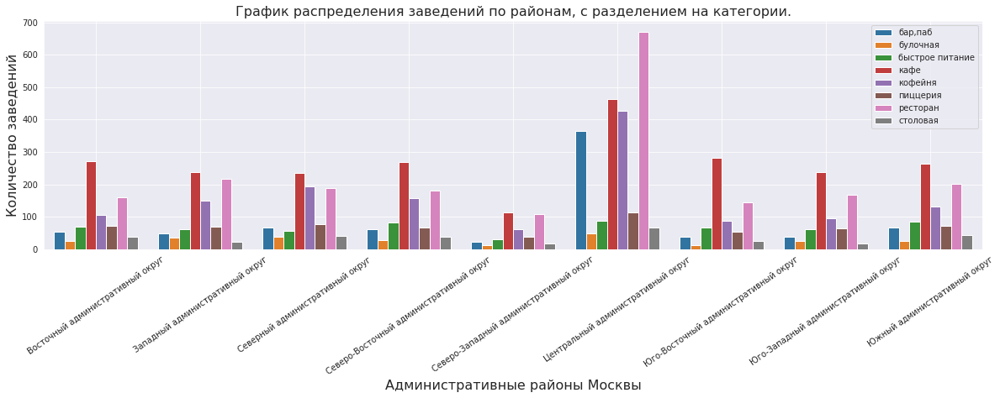

- Всего в датасете 1413 кофеин, больше всего их расположенно в центре, это связанно вероятно с тем что в центре много культурных мест предпочитаемых для прогулок, а во время прогулок появляется желание где нибудь сесть и передохнуть за чаем или кофе. А если в этом месте можно ещё и перекусить то кофейни отлично пожоходят под этот запрос. В северо-западном округе находится наименьше количество кофеин, но при это там в целом меньше заведений чем в дргуих районах. Он считается экологическим районом с монжеством зелёных територий может ли там быть более строгие требования к размещению заведений или меньше пригодных мест для помещений надо проводить другое иследование. Гипотеза: кофеен больше в районах где есть много мест для прогулок или люди проводят досуг. В идеале место искать в центре, но там выше конкурентоспособность. Меньше будет в северном округе и в западном.

### Есть ли круглосуточные кофейни?

In [118]:
df_is_24_7 = df.query('is_24_7 == "круглосуточно"') 
df_is_24_7.head()

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats,street,is_24_7
10,great room bar,"бар,паб","Москва, Левобережная улица, 12,",Северный административный округ,"ежедневно, круглосуточно",55.877832,37.469171,4.5,средние,Цена бокала пива:250–350 ₽,NaN,NaN,не сетевой,102.0,Левобережная улица,круглосуточно
17,чайхана беш-бармак,ресторан,"Москва, Ленинградское шоссе, 71Б, стр. 2,",Северный административный округ,"ежедневно, круглосуточно",55.876908,37.449876,4.4,средние,Средний счёт:350–500 ₽,425.0,NaN,не сетевой,96.0,Ленинградское шоссе,круглосуточно
19,пекарня,булочная,"Москва, Ижорский проезд, 5,",Северный административный округ,"ежедневно, круглосуточно",55.887969,37.515688,4.4,NaN,NaN,NaN,NaN,сетевой,NaN,Ижорский проезд,круглосуточно
24,drive café,кафе,"Москва, улица Дыбенко, 9Ас1,",Северный административный округ,"ежедневно, круглосуточно",55.879992,37.481571,4.0,NaN,NaN,NaN,NaN,сетевой,NaN,улица Дыбенко,круглосуточно
49,2u-ту-ю,пиццерия,"Москва, Ижорская улица, 8А,",Северный административный округ,"ежедневно, круглосуточно",55.886160,37.508784,2.7,NaN,Средний счёт:900 ₽,900.0,NaN,не сетевой,NaN,Ижорская улица,круглосуточно


In [119]:
cofee_house_is_24_7 = df_is_24_7[df_is_24_7['category'] == 'кофейня']['name'].to_frame()
cofee_house_is_24_7.columns = ['name']
#= cofee_house_is_24_7.to_frame().reset_index()
cofee_house_is_24_7.head()

,name
200,wild bean
971,wild bean cafe
1047,wild bean cafe
1214,wild bean cafe
1291,шоколадница


In [120]:
cofee_house_is_24_7['name'].count()

59

In [121]:
cofee_house_is_24_7['name'] = cofee_house_is_24_7['name'].apply(lambda x:{'the wild bean cafe': 'wild bean cafe', 'wild bean': 'wild bean cafe'}.get(x, x))

In [122]:
cofee_house_is_24_7['name'] = cofee_house_is_24_7['name'].apply(lambda x:{'one&double': 'one and double', 'кофейня one&double': 'one and double'}.get(x, x))

In [123]:

cofee_house_is_24_7 = cofee_house_is_24_7['name'].value_counts().to_frame().reset_index()
cofee_house_is_24_7.columns = ['name','count']
cofee_house_is_24_7

,name,count
0,шоколадница,17
1,wild bean cafe,12
2,кофемания,8
3,one and double,3
4,кофе хауз,3
5,cofix,2
6,кофе с собой,2
7,you&coffee,2
8,one price coffee,1
9,cinnabon,1


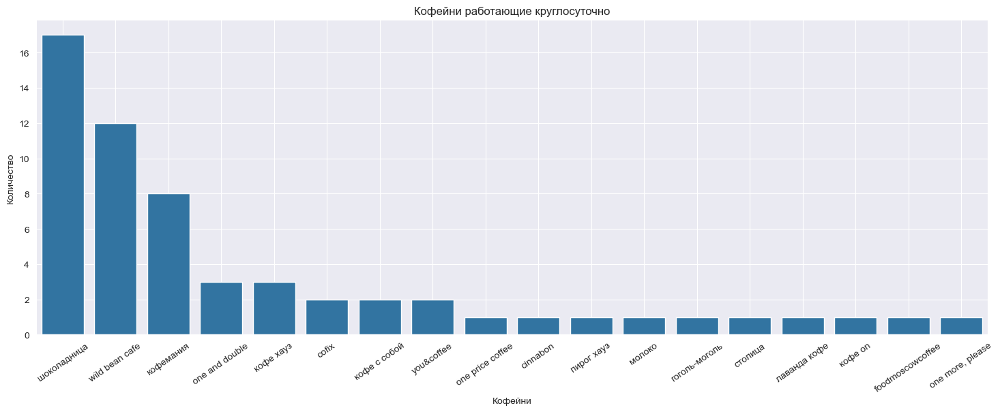

In [124]:
sns.set_style('dark')
plt.figure(figsize=(18, 6))
sns.barplot(x='name', y='count', data=cofee_house_is_24_7)
plt.xlabel('Кофейни')
plt.ylabel('Количество')
plt.title('Кофейни работающие круглосуточно')
plt.xticks(rotation=35)
plt.grid()
plt.show()

- есть 59 кофеин работающих в круглосуточном режиме и большая часть из них это сетевые. Лидеры по круглосуточным кофейням это Шоколадница, wild been cafe и кофемания.

### Какие у кофеен рейтинги? Как они распределяются по районам?

In [125]:
df_coffee_house = df[df['category'] == 'кофейня']
df_coffee_house.head()

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats,street,is_24_7
3,dormouse coffee shop,кофейня,"Москва, улица Маршала Федоренко, 12,",Северный административный округ,"ежедневно, 09:00–22:00",55.881608,37.488860,5.0,NaN,Цена чашки капучино:155–185 ₽,NaN,170.0,не сетевой,NaN,улица Маршала Федоренко,не круглосуточно
25,в парке вкуснее,кофейня,"Москва, парк Левобережный,",Северный административный округ,"ежедневно, 10:00–21:00",55.878453,37.460028,4.3,NaN,NaN,NaN,NaN,сетевой,NaN,парк Левобережный,не круглосуточно
45,9 bar coffee,кофейня,"Москва, Коровинское шоссе, 41, стр. 1,",Северный административный округ,пн-пт 08:00–18:00,55.885837,37.513422,4.0,NaN,NaN,NaN,NaN,сетевой,46.0,Коровинское шоссе,не круглосуточно
46,cofefest,кофейня,"Москва, улица Маршала Федоренко, 6с1,",Северный административный округ,пн-пт 09:00–19:00,55.879934,37.492522,3.6,NaN,NaN,NaN,NaN,сетевой,NaN,улица Маршала Федоренко,не круглосуточно
52,cofix,кофейня,"Москва, улица Дыбенко, 7/1,",Северный административный округ,"ежедневно, 08:00–22:00",55.878531,37.479395,3.8,NaN,NaN,NaN,NaN,сетевой,NaN,улица Дыбенко,не круглосуточно


In [126]:
rating_map_coffee_house = df_coffee_house.groupby('district', as_index=False)['rating'].agg('mean')
rating_map_coffee_house

,district,rating
0,Восточный административный округ,4.282857
1,Западный административный округ,4.195333
2,Северный административный округ,4.291710
3,Северо-Восточный административный округ,4.216981
4,Северо-Западный административный округ,4.325806
5,Центральный административный округ,4.336449
6,Юго-Восточный административный округ,4.225843
7,Юго-Западный административный округ,4.283333
8,Южный административный округ,4.232824


In [127]:
m4 = Map(location=[moscow_lat, moscow_lng], zoom_start=10, tiles='Cartodb Positron')
Choropleth(
    geo_data=state_geo,
    data=rating_map_coffee_house,
    columns=['district', 'rating'],
    key_on='feature.name',
    fill_color='YlOrRd',
    fill_opacity=0.5,
    legend_name='Средний рейтинг кофеин по районам',
).add_to(m4)

# выводим карту
m4

- В среднем рейтинг кофеин состовляет от 4.2 до 4.34 балов. Лучшие по рейтингу районы это центр и Северо-Западный административный округ. С наименьшим средним рейтингом кофейни расположенны в Западном административном округе и Северо-Восточном административном округе

### На какую стоимость чашки капучино стоит ориентироваться при открытии и почему?

- Построить визуализации. Попробовать дать рекомендацию для открытия нового заведения. Это творческое задание, но решение должно быть чем-то обосновано. Объяснить свою рекомендацию  текстом с описанием или маркерами на географической карте.

In [128]:
df.columns

Index(['name', 'category', 'address', 'district', 'hours', 'lat', 'lng',
       'rating', 'price', 'avg_bill', 'middle_avg_bill', 'middle_coffee_cup',
       'chain', 'seats', 'street', 'is_24_7'],
      dtype='object')

In [129]:
df_coffee_house['middle_coffee_cup'].mean()

175.0556621880998

In [130]:
df_coffee_house['middle_coffee_cup'].median()

170.0

In [131]:
df_coffee_house['rating'].value_counts().head(10)

rating
4.3    261
4.4    228
4.2    202
4.1    170
4.5     95
4.0     78
4.7     77
4.6     61
3.9     38
5.0     37
Name: count, dtype: int64

In [132]:
df_coffee_house_good_rating = df_coffee_house.query('rating >= 4')

In [133]:
df_coffee_house_good_rating['rating'].value_counts().head(10)

rating
4.3    261
4.4    228
4.2    202
4.1    170
4.5     95
4.0     78
4.7     77
4.6     61
5.0     37
4.9     37
Name: count, dtype: int64

In [134]:
df_coffee_house_good_rating['middle_coffee_cup'].mean()

177.64300202839758

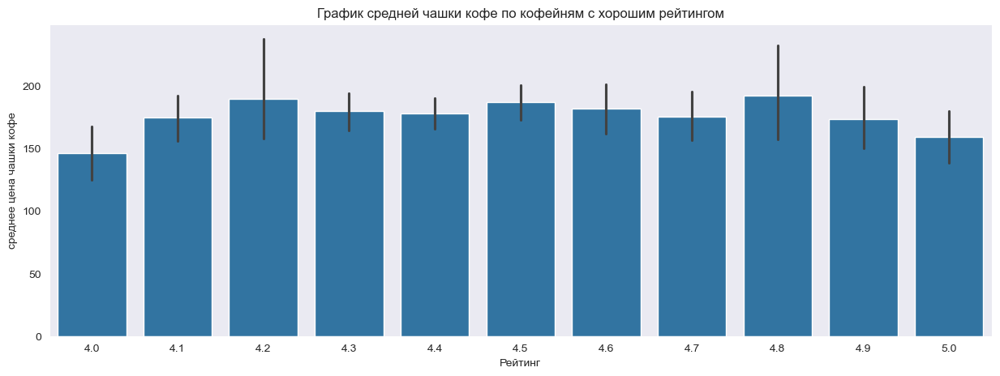

In [135]:
plt.figure(figsize=(15, 5))
sns.barplot(x='rating', y='middle_coffee_cup', data=df_coffee_house_good_rating)
plt.xlabel('Рейтинг')
plt.ylabel('среднее цена чашки кофе')
plt.title('График средней чашки кофе по кофейням с хорошим рейтингом')
plt.show()

- У кофеин с самым высоким рейтингом, цена за чашку кофе от 160 до 175 рублей. То есть не сильно дешефле или дороже средней цены.

In [136]:
df_coffee_house_good_rating_map = df_coffee_house_good_rating.groupby('district')['middle_coffee_cup'].mean().to_frame().reset_index()
df_coffee_house_good_rating_map

,district,middle_coffee_cup
0,Восточный административный округ,179.871795
1,Западный административный округ,195.439024
2,Северный административный округ,169.000000
3,Северо-Восточный административный округ,169.375000
4,Северо-Западный административный округ,173.210526
5,Центральный административный округ,187.518519
6,Юго-Восточный административный округ,150.718750
7,Юго-Западный административный округ,185.468750
8,Южный административный округ,161.750000


In [137]:
m5 = Map(location=[moscow_lat, moscow_lng], zoom_start=10, tiles='Cartodb Positron')
Choropleth(
    geo_data=state_geo,
    data=df_coffee_house_good_rating_map,
    columns=['district', 'middle_coffee_cup'],
    key_on='feature.name',
    fill_color='YlOrRd',
    fill_opacity=0.5,
    legend_name='Средний чек чашек кофе по районам',
).add_to(m5)

# выводим карту
m5

- У кофеин с рейтингом больше 4х балов наибольший средний чек за чашку кофе в Западном, центральном и Юго-Западном округе от 180 до 195 рублей. И самый дешёвый в юго-восточном округе 150 рублей.

### Совокупные промежуточне выводы.
- Всего в датасете 1413 кофеин, больше всего их расположенно в центре, это связанно вероятно с тем что в центре много культурных мест предпочитаемых для прогулок, а во время прогулок появляется желание где нибудь сесть и передохнуть за чаем или кофе. А если в этом месте можно ещё и перекусить то кофейни отлично подоходят под этот запрос. В северо-западном округе находится наименьше количество кофеин, но при это там в целом меньше заведений чем в дргуих районах. Он считается экологическим районом с монжеством зелёных територий может ли там быть более строгие требования к размещению заведений или меньше пригодных мест для помещений надо проводить другое иследование. Гипотеза: кофеен больше в районах где есть много мест для прогулок или люди проводят досуг. В идеале место искать в центре, но там выше конкурентоспособность. Меньше будет в северном округе и в западном.
- есть 59 кофеин работающих в круглосуточном режиме и большая часть из них это сетевые. Лидеры по круглосуточным кофейням это Шоколадница, wild been cafe и кофемания.
- В среднем рейтинг кофеин состовляет от 4.2 до 4.34 балов. Лучшие по рейтингу районы это центр и Северо-Западный административный округ. С наименьшим средним рейтингом кофейни расположенны в Западном административном округе и Северо-Восточном административном округе
- У кофеин с самым высоким рейтингом, цена за чашку кофе от 160 до 175 рублей. То есть не сильно дешефле или дороже средней цены.
- У кофеин с рейтингом больше 4х балов наибольший средний чек за чашку кофе в Западном, центральном и Юго-Западном округе от 180 до 195 рублей. И самый дешёвый в юго-восточном огруге 150 рублей.

### Вывод и рекомендации.
Основываясь на предоставленной информации, можно дать следующие рекомендации по открытию кофейни:
1. Выбор местоположения: Учитывая, что большинство кофеен расположены в центре города, это может быть идеальным местом для открытия нового заведения. Однако, следует учесть высокую конкуренцию в этом районе. Также стоит обратить внимание на Северо-Западный административный округ, где меньше всего кофеен, но при этом меньше заведений в целом. Это может означать, что спрос на новые заведения здесь выше.
2. Формат работы: Если вы рассматриваете возможность работы круглосуточно, обратите внимание на лидеров в этой области – Шоколадницу, Wild Been Cafe и Кофеманию. Это может помочь вам определить, насколько востребован такой формат работы в вашем регионе.Ценообразование: Средняя цена за чашку кофе в кофейнях с высоким рейтингом составляет от 160 до 175 рублей. Это может служить ориентиром для вашего ценообразования.
3. Средний чек: В районах с высоким средним рейтингом кофеен, средний чек за чашку кофе варьируется от 180 до 195 рублей. Это может указывать на то, что посетители готовы платить больше за качественный сервис и атмосферу.
4. Конкуренция: Открытие кофейни в центре города может потребовать значительных усилий для привлечения клиентов из-за высокой конкуренции. Однако, правильный выбор формата работы, ценообразование и качество обслуживания могут помочь вам выделиться среди конкурентов.
5. Исследование рынка: Адаптация к местным условиям: Учтите специфику выбранного вами района. Например, в Северо-Западном административном округе, который считается экологическим районом с множеством зеленых территорий, могут быть более строгие требования к размещению заведений или меньше пригодных мест для помещений.Следуя этим рекомендациям, вы сможете открыть успешную кофейню, которая будет соответствовать потребностям и ожиданиям ваших клиентов.

## Шаг 5.подготовить перезентацию

https://docs.google.com/presentation/d/1RRWq3eZiTnftESLxMM3euJ6crufamGcM7QF8kQdio-M/edit?usp=sharing